In [2]:
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
import os
import yaml
#from dotenv import load_dotenv

import Mandelbrot #defined/customized functions from Mandelbrot.py

import scipy
from scipy.stats import norm, cauchy, lognorm, expon, kstest



In [ ]:
MIN = Mandelbrot.process_csv(gran="min")
HOUR = Mandelbrot.process_csv(gran="hour")
DAY = Mandelbrot.process_csv(gran="day")
WEEK = Mandelbrot.process_csv(gran="week")
MONTH = Mandelbrot.process_csv(gran="month")

In [4]:
def hurst_exponent(DF):
    n = len(DF)
    print("chunk size:",n)
    T = np.arange(1, n+1)
    Y = np.cumsum (DF['high'] - np.mean(DF['high']))
    R = np.maximum.accumulate(Y) - np.minimum.accumulate(Y)
    S = np.std(DF['high'])
    R_S = R/S
    
    H = np.log(R_S).mean()/np.log(n)
    
    return H

''

In [6]:
df = DAY

### 1. Index vs delta index / raw vs logarithm

The logarithm of the deltas gives a more informative picture than the raw index values.
-> shows the growth in relation to the overall data and suposible bull runs seem less impressive 



## Thesis 1: Logarithm Charts represents the market behaviour more truthfully

[nan, -0.775472401825323, -1.3903820901528157, 0.018395825412386844, -0.9280712049099684, -0.7020340092541884, 1.4351315257544577, -0.6431386932936758, -0.8955818974327147, -0.7856994752680366, -0.6729722796761102, -0.6454625680667018, -1.111988639384918, 0.7989377052056565, -0.1790302300970597, -0.7428640204084518, -0.7274168438497168, -0.9092324682842888, -1.2583270051560773, 0.16332330105826953, -0.7598683313756112, 0.9680203933935947, 1.372628417807508, -0.8068458715856465, -0.6493845420710055, 0.9647597273065349, 1.0746280377912485, 1.0754709970521277, -0.7576208186627478, -0.8648047340287508, -0.9343461620762555, 0.8801263021690886, 0.019739126645791978, -0.4626894796086034, 0.4008776549969668, -0.4673096047509613, 0.07906462988696183, -1.2400582824062563, -0.5111241831906165, 0.29662569628231555, -0.15971409628106262, 0.07812408903784292, -0.35976185776213193, -0.44225789375939917, -0.3219490893823046, -0.6248475090486121, -0.9621617954578872, 0.6877815501057606, -0.403816485268

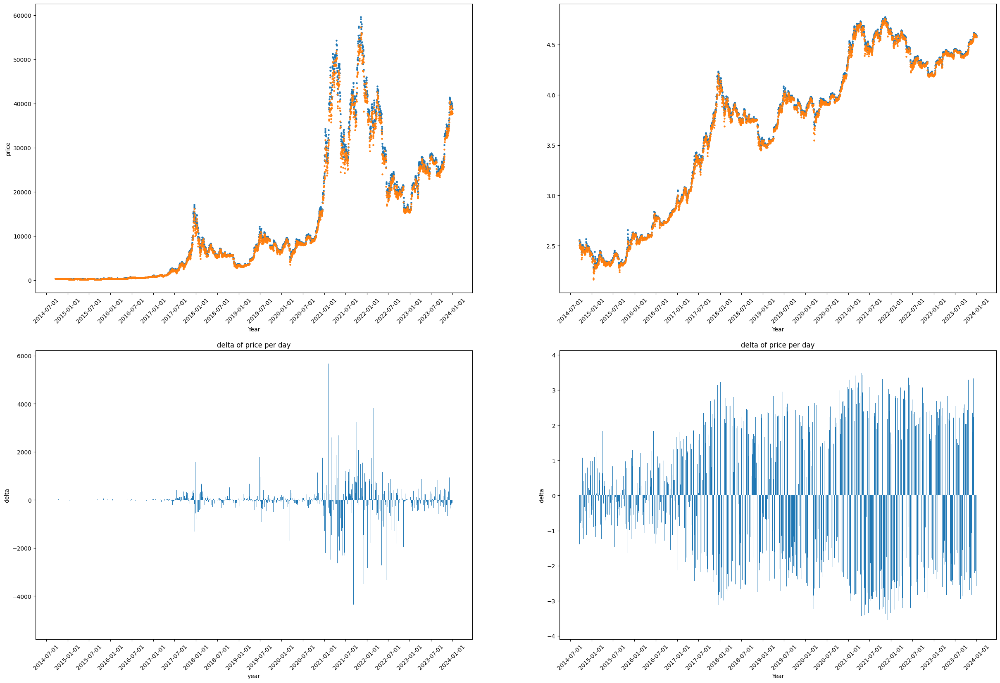

In [7]:
fig = plt.figure(figsize=(30,20))


plt.subplot(2, 2, 1)

plt.scatter(df["date"], df["high"], s=5, label="high")
plt.scatter(df["date"], df["low"], s=5, label="low")
#x-axis format
plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y-%m-%d'))
plt.gca().xaxis.set_major_locator(plt.matplotlib.dates.MonthLocator(bymonth=(1,7)))

#rotate x axis
plt.xticks(rotation=45)
plt.xlabel("Year")

plt.ylabel("price")




plt.subplot(2, 2, 2)
plt.scatter(df["date"], Mandelbrot.log10(df["high"]), s=5, label="high")
plt.scatter(df["date"], Mandelbrot.log10(df["low"]), s=5, label="low")

#x-axis format
plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y-%m-%d'))
plt.gca().xaxis.set_major_locator(plt.matplotlib.dates.MonthLocator(bymonth=(1,7)))

#rotate x axis
plt.xticks(rotation=45)
plt.xlabel("Year")





plt.subplot(2, 2, 3)
plt.bar(df["date"], df["delta_high"])
 
plt.xlabel("year")
plt.ylabel("delta")
#x-axis format
plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y-%m-%d'))
plt.gca().xaxis.set_major_locator(plt.matplotlib.dates.MonthLocator(bymonth=(1,7)))

#rotate x axis
plt.xticks(rotation=45)
plt.title("delta of price per day")



print(Mandelbrot.log10(df["delta_high"])[0:50])

plt.subplot(2, 2, 4)
plt.bar(df["date"], Mandelbrot.log10(df["delta_high"]))

 
plt.xlabel("Year")
plt.ylabel("delta")
#x-axis format
plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y-%m-%d'))
plt.gca().xaxis.set_major_locator(plt.matplotlib.dates.MonthLocator(bymonth=(1,7)))

#rotate x axis
plt.xticks(rotation=45)
plt.title("delta of price per day")

plt.show()

### Probability density function of delta values

it is widely accepted, that the values follow a normal distribution

Mandelbrot suggests, that it is rather a Cauchy distribution

Cauchy:
-> higher peak around the mean
-> no fixed variance
-> more considerate of frequent "higher" outliers (turbulences in the market)


When to Use Cauchy Instead of Gaussian?

Choose Cauchy if:

    You see extreme outliers

    Data has heavy tails (outliers that don't “go away” with more samples)

    Mean and variance don't make sense (or are misleading)

Choose Gaussian if:

    Data clusters well around a central value

    Tails decay quickly (no big outliers)

## Thesis 2 Fat tails: the distribution follows a Cauchy PDF

#How is it tested?

The delta values are plotted (Histogramm)
Different PDFs are calculated (norm, cauchy etc)

--> what is the best way to evaluate the  best fit?
Kolmogorov



In [5]:
import seaborn as sb
from pathlib import Path

distdict = yaml.safe_load(Path('static/dist_color.yml').read_text())

print(distdict)

{'cauchy': 'pink', 'expon': 'r', 'lognorm': 'g', 'norm': 'k'}


In [3]:
#Analyzing how the fit works (for Gauss)

data = MONTH["delta_high"].dropna()

#getattr?
dist = getattr(scipy.stats, "norm") #creates an object according to the parameters
#print(dist)
params = dist.fit(data,method="mle") #fits the given pdf to the data via MLE

print(params)

arg = params[:-2]
loc = params[-2]
scale = params[-1]


print("arg:",arg)
print("loc:",loc)  #sigma (variance) for gauss
print("scale:",scale) #mu (mean) for gauss

x = np.linspace(scale - 3*loc, scale + 3*loc, 100)
print("testdata")
print(x)

def gauss_pdf(x, mu, sigma):
   
    Gauss_data = (1 / (sigma * np.sqrt(2 * np.pi))) * np.exp(-(x - mu)**2 / (2 * sigma**2))
    
    return Gauss_data


print("Guass Data:")
print(gauss_pdf(x,scale,loc))

(710.5827306845022, 5067.084930787807)
arg: ()
loc: 710.5827306845022
scale: 5067.084930787807
testdata
[2935.33673873 2978.40235878 3021.46797882 3064.53359886 3107.5992189
 3150.66483894 3193.73045898 3236.79607902 3279.86169907 3322.92731911
 3365.99293915 3409.05855919 3452.12417923 3495.18979927 3538.25541932
 3581.32103936 3624.3866594  3667.45227944 3710.51789948 3753.58351952
 3796.64913956 3839.71475961 3882.78037965 3925.84599969 3968.91161973
 4011.97723977 4055.04285981 4098.10847985 4141.1740999  4184.23971994
 4227.30533998 4270.37096002 4313.43658006 4356.5022001  4399.56782014
 4442.63344019 4485.69906023 4528.76468027 4571.83030031 4614.89592035
 4657.96154039 4701.02716044 4744.09278048 4787.15840052 4830.22402056
 4873.2896406  4916.35526064 4959.42088068 5002.48650073 5045.55212077
 5088.61774081 5131.68336085 5174.74898089 5217.81460093 5260.88022097
 5303.94584102 5347.01146106 5390.0770811  5433.14270114 5476.20832118
 5519.27394122 5562.33956126 5605.40518131 56

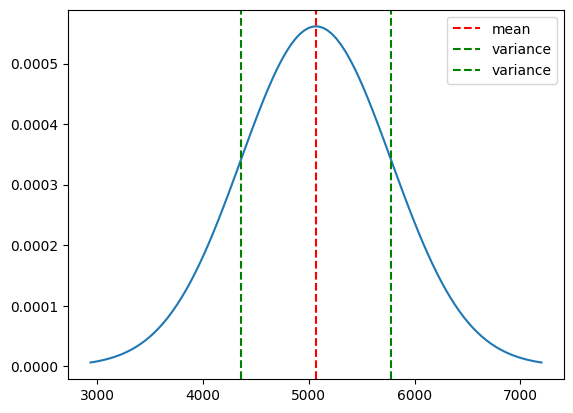

In [4]:
#reconstructing Gauss from fit
plt.plot(x, gauss_pdf(x,scale,loc))
plt.axvline(scale, color='red', linestyle='--', label='mean')
plt.axvline(scale-loc, color='green', linestyle='--', label='variance')
plt.axvline(scale+loc, color='green', linestyle='--', label='variance')
plt.legend()
plt.show()

In [5]:
#analyze fit for cauchy

dist = getattr(scipy.stats, "cauchy") #creates an object according to the parameters
#print(dist)
params = dist.fit(data,method="mle") #fits the given pdf to the data via MLE

print(params)

arg = params[:-2]
loc = params[-2]
scale = params[-1]


print("arg:",arg)
print("loc:",loc)  #x0 (peak value) for cauchy
print("scale:",scale) #gamma (the distance from the peak x0 where the PDF drops to half its maximum value) for cauchy

x = np.linspace(loc - 5*scale, loc + 5*scale, 500)

def cauchy_pdf(x,x0,gamma):
    
    Cauchy_data = 1 / (np.pi * gamma * (1 + ((x - x0)/gamma)**2))
    
    return Cauchy_data


(72.1785187923022, 1073.44949476017)
arg: ()
loc: 72.1785187923022
scale: 1073.44949476017


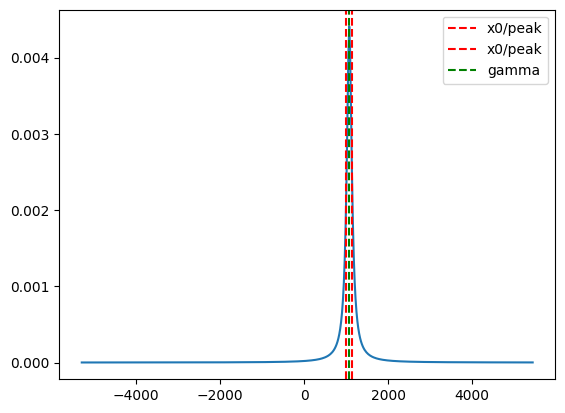

In [6]:
#reconstructing Cauchy from fit
plt.plot(x, cauchy_pdf(x,scale,loc))
plt.axvline(scale-loc, color='red', linestyle='--', label='x0/peak')
plt.axvline(scale+loc, color='red', linestyle='--', label='x0/peak')
plt.axvline(scale, color='green', linestyle='--', label='gamma')
#plt.axvline(scale+loc, color='green', linestyle='--', label='variance')
plt.legend()
plt.show()

In [26]:
# how to determine which fit is the best?

#GAUSS
#gauss_dist = getattr(scipy.stats, "gauss") #creates an object according to the parameters
#print(dist)
gauss_params = scipy.stats.norm.fit(data,method="mle")

#CAUCHY
#cauchy_dist = getattr(scipy.stats, "cauchy") #creates an object according to the parameters
#print(dist)
cauchy_params = scipy.stats.cauchy.fit(data,method="mle")


#Log Likelihood
#---> Compares how well the Model fits
#higher == better
loglik_gauss = np.sum(norm.logpdf(data, *gauss_params))
loglik_cauchy = np.sum(cauchy.logpdf(data, *cauchy_params))

print(f"Log-likelihood (Gauss): {loglik_gauss}")
print(f"Log-likelihood (Cauchy): {loglik_cauchy}")


#Akaikon Information Criterion (AIC)
#uses Loglikelihood values
#-> for models of different complexity (different amount of parameters)
#AIC helps you avoid being tricked by a model that fits well only because it's more complex
#lower == better

def aic(loglik, num_params):
    print(loglik,num_params)
    aic = 2 * num_params - 2 * loglik
    print(aic)
    return aic

aic_gauss = aic(loglik_gauss, 2)
aic_cauchy = aic(loglik_cauchy, 2)

print(f"AIC (Gauss): {aic_norm}")
print(f"AIC (Cauchy): {aic_cauchy}")

#Bayesian Information Criterion (BIC)


#Cramer von Mises
#More balanced than Anderson or KS: cares about both center and tails
#smaller == better
cvm_gauss = scipy.stats.cramervonmises(data, 'norm')
cvm_cauchy = scipy.stats.cramervonmises(data, 'cauchy')

print(f"CVM (Gauss): {cvm_gauss}")
print(f"CVM (Cauchy): {cvm_cauchy}")

#Kolmogorov Smirnov ->>> not suitable/ limited
# anderson ---> not suitable for cauchy

#scipy.stats.cramervonmises?



Log-likelihood (Gauss): -1283.4802755119795
Log-likelihood (Cauchy): -1237.3563776727024
-1283.4802755119795 2
2570.960551023959
-1237.3563776727024 2
2478.7127553454047
AIC (Gauss): 2570.960551023959
AIC (Cauchy): 2478.7127553454047
CVM (Gauss): CramerVonMisesResult(statistic=11.27312062988594, pvalue=3.4848057772762786e-10)
CVM (Cauchy): CramerVonMisesResult(statistic=10.947740469079005, pvalue=1.9998869227322302e-10)


In [12]:
def best_fit(data,PDF = "norm"):
    
    data = data.dropna()
    
    if PDF == "norm":
        params = scipy.stats.norm.fit(data,method="mle")
        #Log Likelihood Gauss
        loglik = np.sum(norm.logpdf(data, *params))
    elif PDF == "cauchy":
        params = scipy.stats.cauchy.fit(data,method="mle")
        #Log Likelihood Cauchy
        loglik = np.sum(cauchy.logpdf(data, *params))
    else:
        print("invalid PDF value")
    
    
    #Akaikon Information Criterion (AIC)
    aic = 2 * 2 - 2 * loglik
    
    #Cramer von Mises
    cvm = scipy.stats.cramervonmises(data, PDF)
    cvm = [cvm.statistic,cvm.pvalue]  #cvm gives an object --> transform to simple list
    
                                        
    return loglik, aic, cvm

In [15]:
ll_gauss, aic_gauss, cvm_gauss = best_fit(MONTH["delta_high"],"norm")
#ll_cauchy, aic_cauchy, cvm_cauchy = best_fit(data,"cauchy")

type(cvm_gauss)
cvm_gauss.statistic
cvm_gauss.pvalue

3.4848057772762786e-10

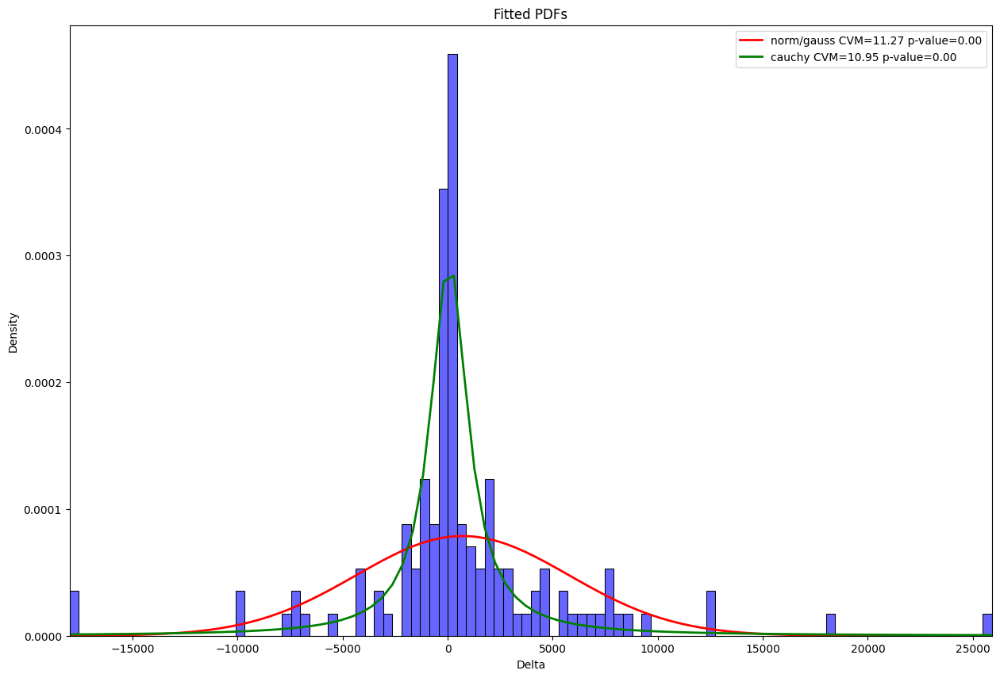

In [29]:
# GAUSS FIT
from scipy.stats import norm, cauchy, lognorm, expon, kstest
data = MONTH["delta_high"].dropna()

#plt.hist(data, bins=100, density=True)
ll_gauss, aic_gauss, cvm_gauss = best_fit(data,"norm")
ll_cauchy, aic_cauchy, cvm_cauchy = best_fit(data,"cauchy")

plt.figure(figsize=(15,10))

sb.histplot(data, bins=100, kde=False, stat = "density", color = 'blue', alpha=0.6)


    
params_gauss, pdf_fitted_gauss, x_gauss = Mandelbrot.gauss_pdf(data)
params_cauchy, pdf_fitted_cauchy, x_cauchy = Mandelbrot.cauchy_pdf(data)

    
plt.plot(x_gauss, pdf_fitted_gauss, 'r', linewidth=2, 
         label="norm/gauss CVM=%.2f p-value=%.2f"%(cvm_gauss[0],cvm_gauss[1]))
plt.plot(x_cauchy, pdf_fitted_cauchy, 'g', linewidth=2, 
         label="cauchy CVM=%.2f p-value=%.2f"%(cvm_cauchy[0],cvm_cauchy[1]))


plt.xlim(min(data),max(data))
plt.legend(loc="upper right")
plt.xlabel('Delta')
plt.ylabel('Density')
plt.title('Fitted PDFs')
#plt.savefig("PDF.png")
plt.show()

In [10]:
def plot_fit(DF):
    from scipy.stats import norm, cauchy, lognorm, expon, kstest
    data = DF["delta_high"].dropna()

    #plt.hist(data, bins=100, density=True)
    ll_gauss, aic_gauss, cvm_gauss = best_fit(data,"norm")
    ll_cauchy, aic_cauchy, cvm_cauchy = best_fit(data,"cauchy")

    fig = plt.figure(figsize=(15,10))

    sb.histplot(data, bins=500, kde=False, stat = "density", color = 'blue', alpha=0.6)
    
    params_gauss, pdf_fitted_gauss, x_gauss = Mandelbrot.gauss_pdf(data)
    params_cauchy, pdf_fitted_cauchy, x_cauchy = Mandelbrot.cauchy_pdf(data)

    
    plt.plot(x_gauss, pdf_fitted_gauss, 'r', linewidth=2, 
         label="norm/gauss CVM=%.2f p-value=%.5f"%(cvm_gauss[0],cvm_gauss[1]))
    plt.plot(x_cauchy, pdf_fitted_cauchy, 'g', linewidth=2, 
         label="cauchy CVM=%.2f p-value=%.5f"%(cvm_cauchy[0],cvm_cauchy[1]))


    plt.xlim(min(data),max(data))
    plt.legend(loc="upper right")
    plt.xlabel('Delta')
    plt.ylabel('Density')
    plt.title('Fitted PDFs')
    
    return fig

In [11]:
fig = plot_fit(HOUR)


NameError: name 'best_fit' is not defined

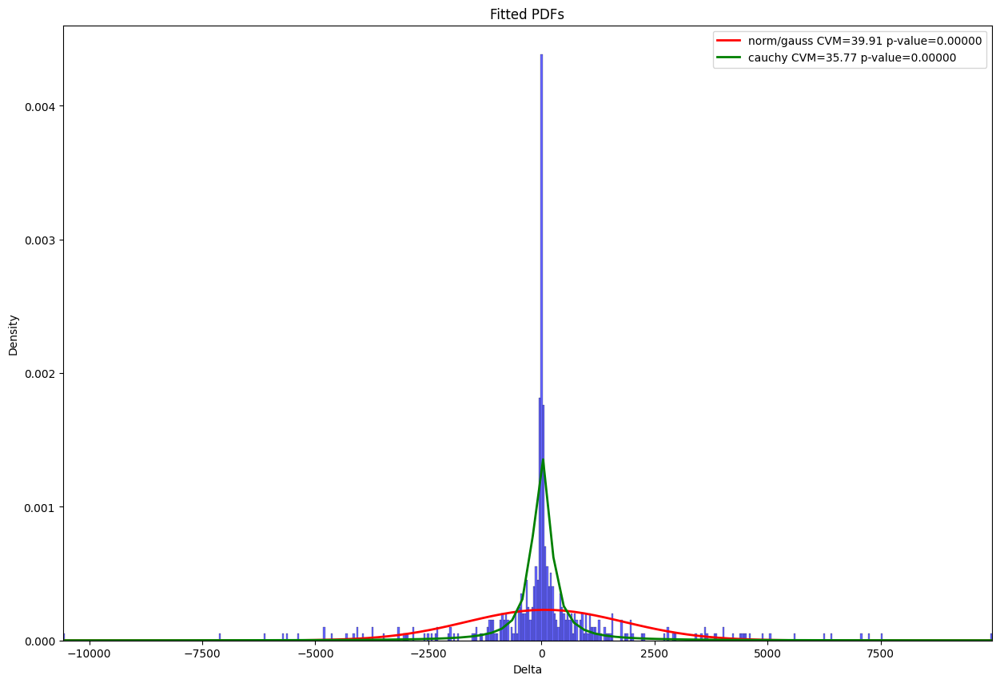

In [13]:
fig = plot_fit(WEEK)

In [26]:
HOUR.head()

,unix,date,high,low,delta_high,delta_low
2,1609700400,2021-01-03 19:00:00,26028.02,25959.78,NaN,NaN
62,1609704000,2021-01-03 20:00:00,25924.91,25896.15,-103.11,-63.63
122,1609707600,2021-01-03 21:00:00,26670.77,26621.29,745.86,725.14
182,1609711200,2021-01-03 22:00:00,26580.99,26478.00,-89.78,-143.29
242,1609714800,2021-01-03 23:00:00,26224.14,26143.79,-356.85,-334.21


# 3. The memory of data

## old patterns correlate with newer patterns

## Hurt exponent / Variance

In [26]:
DAY.index.to_list()

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


In [43]:
#correlation Heatmap
from scipy.stats import pearsonr
import statsmodels.api as sm

DF = DAY[["date","high"]]
corr, p_val = pearsonr(DAY.index.to_list(),DAY['high'])


print(corr)


ModuleNotFoundError: No module named 'statsmodels'

In [30]:
def hurst_exponent(DF):
    n = len(DF)
    print("chunk size:",n)
    T = np.arange(1, n+1)
    Y = np.cumsum (DF['high'] - np.mean(DF['high']))
    R = np.maximum.accumulate(Y) - np.minimum.accumulate(Y)
    S = np.std(DF['high'])
    R_S = R/S
    
    H = np.log(R_S).mean()/np.log(n)
    
    return H

In [ ]:
#calculating Hurst with rolling window
DF = HOUR

#define chunk size (by the power of two)
power=10
n = 2**power

#initalize lists
hurst_series = []
tstats_series = []
pvalues_series = []

for t in np.arange(n,len(DF)+1):
    chunk = DF['high'][t-n:t]
    #print(len(chunk))
    X = np.arange(2,power+1) #number of observations/ altering might reduce noise (or introduce it)
    Y = np.array([]) #
    print(f"LEVEL 1 ----- Iteration of time chunks of length {n}-----")
    print("starting at:",t-n)
    print("power of number of observations to loop through:",X)
    
    for p in X:
        print("LEVEL 2 -----Iteration of number of observation------")
        m = 2**p  #number of observations in a subsample
        print("Number of Observations in the subsample:",m)
        s = 2**(power-p) #number of subsamples
        print("Number of subsamples",s)
        rs = np.array([])
        
        for i in np.arange(0,s):
            print("LEVEL 3 -----Iteration through all subsamples----")
            subsample = chunk[i*m:(i+1)*m]
            print("length of subsample:",len(subsample))
            mean = np.average(chunk)
            print("mean:",mean)
            deviate = np.cumsum(chunk-mean)
            diff = max(deviate) - min(deviate)
            print("difference:", diff)
            std = np.std(chunk)
            print("standartdeviation:", std)
            rescaled_range = diff/std
            rs = np.append(rs, rescaled_range)
            
        print("rescaled range per subsample",rs)
        Y = np.append(Y, np.log2(np.average(rs))) #because we divid by base 2
    print("log2 of the average rescaled range per subsample:",Y)    
    #reg = sm.OLS(Y, sm.add_constant(X))
    #res = reg.fit()
    
    #hurst = res.params[1]
    #tstat = (res.params[1]-0.5)/res.bse[1]
    #pvalue = 2*(1 - sps.t.cdf(abs(tstat),res.df_resid))
    
    H = np.log(Y).mean()/np.log(t)
    hurst_series.append(H)
    #tstats_series.append(tstat)
    #pvalues_series.appen(pvalzue)
    
    

LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 0
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.308509

standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.30850958674755
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.72697265625
difference: 9232.800351562499
standartdeviation: 23.

standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.293975

standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.293975

standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.68583984375
difference: 9215.277773437492
standartdeviation: 23.29397513134378
rescaled range per subsample [395.60777933 395.60777933 395.60777933 395.60777933 395.60777933
 395.60777933 395.60777933 395.60777933 395.60777933 395.60777933
 395.60777933 395.60777933 395.60777933 395.60777933 395.60777933
 395.60777933 395.60777933 395.60777933 395.60777933 395.60777933
 395.60777933 395.

standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.

standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.

standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviation: 23.28111955319925
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.646494140625
difference: 9198.516503906249
standartdeviatio

standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.608994140625
difference: 9182.541503906246
standartdeviatio

standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.608994140625
difference: 9182.541503906246
standartdeviatio

standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartdeviation: 23.269467300754936
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.608994140625
difference: 9182.541503906246
standartde

standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.256870

standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.256870

difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.534257812504
standartdeviation: 23.25687018226372
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.57611328125
difference: 9168.53425

standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.54244140624996
difference: 9154.190039062487
stan

standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.54244140624996
difference: 9154.190039062487
stan

standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.190039062487
standartdeviation: 23.244081326130864
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.54244140624996
difference: 9154.19003906248

standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartde

standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.5087109374999
difference: 9139.820859374971
standartde

standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.5087109374999
difference: 9139.820859374971
standartde

standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
standartdeviation: 23.231286821887803
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.5087109374999
difference: 9139.820859374971
stan

standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviatio

standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.476669921875
difference: 9126.171386718745
standartdeviatio

standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.476669921875
difference: 9126.171386718745
standartdeviatio

standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.476669921875
difference: 9126.171386718745
standartdeviation: 23.220219669680905
rescaled range per subsample [393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.02691863 393.02691863 393.02691863 393.02691863 393.02691863
 393.0269

standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.

standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.

difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.98941

standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
rescaled range per subsample [392.63743801 392.63743801 392.63743801 392.63743801 392.63743801
 392.63743801 392.63743801 392.63743801 392.63743801 392.63743801
 392.63743801 392.63743801 392.63743801 392.63743801 392.63743801
 392.63743801 392.63743801 392.63743801 392.63743801 392.63743801
 392.63743801 392

standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviation: 23.207133431309813
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.44337890625
difference: 9111.989414062506
standartdeviatio

standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
stan

standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.41068359375004
difference: 9098.061210937518
stan

standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.41068359375004
difference: 9098.061210937518
stan

standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.061210937518
standartdeviation: 23.193769526431005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.41068359375004
difference: 9098.06121093751

standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviatio

standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.378525390625
difference: 9084.361816406246
standartdeviatio

difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084

standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
rescaled range per subsample [391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.9

standartdeviation: 23.180191150859194
rescaled range per subsample [391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719 391.90193719 391.90193719 391.90193719
 391.90193719 391.90193719]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.378525390625
difference: 9084.361816406246
standartdeviation: 23.180191150859194
LEVEL 3 -----Iteration through all subsamples----
length 

standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516

standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516

standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516

standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516

standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.166516881953434
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3456640625
difference: 9070.362890625012
standartdeviation: 23.

difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviatio

standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 

difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.3128125
difference: 9056.368125000005
standartdeviatio

standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 

standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LE

standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.3128125
difference: 9056.368125000005
standartdeviation: 23.152827456668902
LE

standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.

standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.

difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.280615234375
difference: 9042.65208

standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.

standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.280615234375
difference: 9042.65208984374
standartdeviatio

difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042.65208984374
standartdeviation: 23.138807936601992
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.280615234375
difference: 9042

difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartde

difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.247734375
difference: 9028.644843749998
standartde

standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEV

difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.247734375
difference: 9028.644843749998
standartde

standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.122359641151

standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
rescaled range per subsample [390.47246838 390.47246838 390.47246838 390.47246838 390.47246838
 390.47246838 390.47246838 390.47246838]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 373.247734375
difference: 9028.644843749998
standartdeviation: 23.12235964115159
LEVEL 3 -----Iteration through all subsamples----
length 

standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviatio

standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.214970703125
difference: 9014.687519531253
standartdeviatio

standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviatio

standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.214970703125
difference: 9014.687519531253
standartdeviatio

difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.214970703125
difference

standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartdeviation: 23.105996858379736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.214970703125
difference: 9014.687519531253
standartde

difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
diff

standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
stan

standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.18145507812494
difference: 9000.409863281222
stan

standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
stan

difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.18145507812494
diff

standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.18145507812494
difference: 9000.40986328122

standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.409863281222
standartdeviation: 23.089583096924443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.18145507812494
difference: 9000.40986328122

standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviatio

difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984

difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.143525390625
difference: 8984

standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviatio

standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.143525390625
difference: 8984.251816406235
standartdeviatio

standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartdeviation: 23.073910333099203
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.143525390625
difference: 8984.251816406235
standartde

standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.

standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.

standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.

standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.

difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.85923

standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.

difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968.859238281235
standartdeviation: 23.06007164845374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.107392578125
difference: 8968

difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviatio

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 

difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.0715625
difference: 8953.595625000014
standartdeviatio

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LE

standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 373.0715625
difference: 8953.595625000014
standartdeviation: 23.046758942504393
LE

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.032799

difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.19472656249

difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.19472656249

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.032799

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.032799

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
rescaled range per subsample [388.06376317 388.06376317 388.06376317 388.06376317 388.06376317
 388.06376317 388.06376317 388.06376317 388.06376317 388.06376317
 388.06376317 388.06376317 388.06376317 388.06376317 388.06376317
 388.06376317 388.06376317 388.06376317 388.06376317 388.06376317
 388.06376317 388.0637

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.

standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
rescaled range per subsample [388.06376317 388.06376317 388.06376317 388.06376317]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 373.03541015625
difference: 8938.194726562499
standartdeviation: 23.03279918101623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 373.03541015625
diffe

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
stan

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
stan

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.99908203125005
difference: 8922.718945312527
stan

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
stan

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.99908203125005
difference: 8922.718945312527
stan

standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.99908203125005
difference: 8922.71894531252

standartdeviation: 23.018548001275427
rescaled range per subsample [387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226 387.63170226
 387.63170226 387.63170226 387.63170226 387.63170226]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the sub

difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.99908203125005
difference: 8922.718945312527
standartdeviation: 23.018548001275427
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.9990820312500

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.

standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.003601455801714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.96298828125
difference: 8907.34300781249
standartdeviation: 23.

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.35552

standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.

standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.925458984375
difference: 8891.35552

standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.35552

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
rescaled range per subsample [386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.7

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.925458984375
difference: 8891

difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.925458984375
difference: 8891.355527343749
standartdeviation: 22.98705130119364
rescaled range per subsample [386.79843756 386.79843756 386.79843756 386.79843756 386.79843756
 386.79843756 386.

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
diff

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
diff

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
diff

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.89001953124995
diff

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
diff

difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.89001953124995
diff

standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.89001953124995
difference: 8876.25832031248

standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.258320312481
standartdeviation: 22.970213843651003
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.89001953124995
difference: 8876.25832031248

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.85482421874997
difference: 8861.265117187484
stan

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.85482421874997
difference: 8861.26511718748

standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
rescaled range per subsample [386.03209134 386.03209134 386.03209134 386.03209134 386.03209134
 386.03209134 386.03209134 386.03209134 386.03209134 386.03209134
 386.03209134 386.03209134 386.03209134 386.03209134 386.03209134
 386.03209134]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.85482421874997
difference: 8861.265117187484
standartdeviation: 22.954736966209197
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.8548242187

standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.

difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.98486

difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.818955078125
difference: 8845.98486

standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.

standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.

difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.818955078125
difference: 8845

standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviation: 22.93915547887323
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.818955078125
difference: 8845.984863281246
standartdeviatio

standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.

standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.

standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.

standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
rescaled range per subsample [385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068 385.2656068
 385.2656068 385.2656068 385.2656068 385.

difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.786533203125
difference: 8832.17314

difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.786533203125
difference: 8832

difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832.173144531243
standartdeviation: 22.92489386206157
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.786533203125
difference: 8832

standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.

difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.37731

difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.37731

standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.

difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.37731

standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.

standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.754111328125
difference: 8818.377314453137
standartdeviatio

standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviation: 22.91039351574302
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.754111328125
difference: 8818.377314453137
standartdeviatio

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
diff

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
diff

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
diff

standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.72200195312496
difference: 8804.730830078108
stan

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
diff

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.72200195312496
diff

standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.72200195312496
difference: 8804.73083007810

standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.72200195312496
difference: 8804.73083007810

difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
rescaled range per subsample [384.54087352 384.54087352 384.54087352 384.54087352]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.72200195312496
difference: 8804.730830078108
standartdeviation: 22.896735916306714
rescaled range per subsample [384.54087352 384.54087352

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviatio

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.69540039062497
difference: 8793.42516601561
standartde

standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartdeviation: 22.88219559888484
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.69540039062497
difference: 8793.42516601561
standartde

standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695

difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.48058593748

standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695

difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.6696484375
difference: 8782.48058593748

standartdeviation: 22.868695111163234
rescaled range per subsample [384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.0394

difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.48058593748

difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.6696484375
difference: 8782.48058593748

standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.

standartdeviation: 22.868695111163234
rescaled range per subsample [384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784 384.03942784 384.03942784 384.03942784
 384.03942784 384.03942784]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.6696484375
difference: 8782.480585937485
standartdeviation: 22.868695111163234
LEVEL 3 -----Iteration through all subsamples----
length of s

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviatio

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviatio

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviatio

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.645400390625
difference: 8772.175166015631
standartdeviatio

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviatio

mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.645400

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.645400390625
difference: 8772.175166015631
standartde

standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.645400390625
difference: 8772.175166015631
standartdeviation: 22.856235678912654
rescaled range per subsample [383.79789609 383.79789609 383.79789609 383.79789609 383.79789609
 383.79789609 383.79789609 383.79789609 383.79789609 383.79789609
 383.79789609 383.79789609 383.79789609 383.79789609 383.79789609
 383.79789609 383.79789609 383.79789609 383.79789609 383.79789609
 383.7978

difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference

standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartde

difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.62186523437504
difference

difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference

standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.62186523437504
difference: 8762.17272460939
standartde

difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.62186523437504
diff

difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
difference: 8762.17272460939
standartdeviation: 22.844755337347006
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.62186523437504
diff

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.833115

difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.85485351562

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.833115

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.833115

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.833115

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.833115

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.

difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
rescaled range per subsample [383.29657151 383.29657151 383.29657151 383.29657151 383.29657151
 383.29657151 383.296571

standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.597587890625
difference: 8751.854853515624
standartdeviation: 22.8331154098263
rescaled range per subsample [383.29657151 383.29657151 383.29657151 383.29657151 383.29657151
 383.29657151 383.29657151 383.29657151]
LEVEL 2 

difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741

difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741

difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.573037109375
difference: 8741

difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741

mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.573037

standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.573037109375
difference: 8741.420771484363
standartde

difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
difference: 8741.420771484363
standartdeviation: 22.820720390795575
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.573037109375
diff

difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.45568359376

standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.809432

standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.809432

standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.809432

difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.54958984375
difference: 8731.45568359376

standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.

standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.80943235426869
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.54958984375
difference: 8731.455683593766
standartdeviation: 22.

difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.10900390625

difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.10900390625

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.799497

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.799497

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.799497

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.799497

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.

standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.79949787623473
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.52759765625
difference: 8722.109003906253
standartdeviation: 22.

standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
stan

standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
stan

difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
diff

standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
stan

difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.50603515625005
diff

standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
stan

difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.50603515625005
diff

difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.5060351562500

difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.50603515625005
difference: 8712.944941406273
standartdeviation: 22.789562383160224
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.5060351562500

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
stan

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
stan

standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
stan

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.484609375
difference: 8703.838984375001
stan

standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821

standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.484609375
difference: 8703.83898437500

difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.838984375001
standartdeviation: 22.779721811821467
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.484609375
difference: 8703.83898437500

difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
diff

difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
diff

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
stan

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.45902343750004
difference: 8692.964960937517
stan

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
stan

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.45902343750004
difference: 8692.964960937517
stan

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.45902343750004
difference: 8692.96496093751

standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.45902343750004
difference: 8692.96496093751

length of subsample: 1024
mean: 372.45902343750004
difference: 8692.964960937517
standartdeviation: 22.765544792743004
rescaled range per subsample [381.84743831]
log2 of the average rescaled range per subsample: [8.57685253 8.57685253 8.57685253 8.57685253 8.57685253 8.57685253
 8.57685253 8.57685253 8.57685253]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 41
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
diff

difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
diff

standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.43436523437504
difference: 8682.485224609392
stan

difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
diff

difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.43436523437504
diff

standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.48522460939

standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
rescaled range per subsample [381.60828002 381.60828002 381.60828002 381.60828002 381.60828002
 381.60828002 381.60828002 381.6

difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.43436523437504
difference: 8682.485224609392
standartdeviation: 22.752350195986846
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.4343652343750

difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference

standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartde

difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference

standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.40960937500006
difference: 8671.963984375025
standartde

standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartde

standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.40960937500006
difference: 8671.963984375025
standartde

standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.40960937500006
difference: 8671.963984375025
stan

difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.40960937500006
diff

difference: 8671.963984375025
standartdeviation: 22.73901430850537
rescaled range per subsample [381.36938861 381.36938861 381.36938861 381.36938861]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
rescaled range per subsample [381.36938861 381.36938861]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 372.40960937500006
difference: 8671.963984375025
standartdeviation: 22.73901430850537
rescaled range per subsample [381.36938861]
lo

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
diff

standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
stan

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.38603515624993
diff

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
diff

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
diff

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.38603515624993
diff

standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.38603515624993
difference: 8661.94494140621

difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
rescaled range per subsample [381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918 381.13965918 381.13965918 381.13965918
 381.13965918 381.13965918]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.38603515624993
difference: 8661.944941406218
standartdeviation: 22.726433035097347
LEVEL 3 -----Iteration 

standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.78063

standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.362119140625
difference: 8651.78063

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.78063

standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.362119140625
difference: 8651.78063

standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.362119140625
difference: 8651.780634765622
standartdeviatio

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.362119140625
difference: 8651

difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
rescaled range per subsample [380.91773756 380.91773756 380.91773756 380.91773756]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.362119140625
difference: 8651.780634765622
standartdeviation: 22.71298966049685
rescaled range per subsample [380.91773756 380.91773756]
LEVEL 2 ---

difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.57067

difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.57067

difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.57067

difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.338095703125
difference: 8641.57067

difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.57067

standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.

standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.338095703125
difference: 8641.570673828137
standartdeviatio

standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviation: 22.69874872193668
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.338095703125
difference: 8641.570673828137
standartdeviatio

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.31356445312497
difference: 8631.14489257811
standartde

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.31356445312497
difference: 8631.14489257811
stan

standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.31356445312497
difference: 8631.14489257811
stan

standartdeviation: 22.683976617974857
rescaled range per subsample [380.49522965 380.49522965 380.49522965 380.49522965]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
rescaled range per subsample [380.49522965 380.49522965]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 372.31356445312497
difference: 8631.14489257811
standartdeviation: 22.683976617974857
rescaled range per subsample [380.49522965]
log2 of the average rescaled ra

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartde

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartde

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartde

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
rescaled range per subsample [380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 380.30034266 380.30034266
 380.30034266 380.30034266 380.30034266 38

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartde

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.28622070312497
difference: 8619.52379882811
standartde

standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.28622070312497
difference: 8619.52379882811
stan

difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
difference: 8619.52379882811
standartdeviation: 22.665043471835578
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.28622070312497
diff

difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.96496093750

difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.96496093750

difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.96496093750

standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073

standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073

standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073

standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.

standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.646073227826403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.2590234375
difference: 8607.964960937501
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.

difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.230576171875
difference: 8595

standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviation: 22.62572648091371
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.230576171875
difference: 8595.874873046869
standartdeviatio

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
stan

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
stan

difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
diff

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.20133789062504
difference: 8583.448603515642
stan

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
stan

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.20133789062504
difference: 8583.448603515642
stan

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.20133789062504
difference: 8583.44860351564

standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.448603515642
standartdeviation: 22.606186797220577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.20133789062504
difference: 8583.44860351564

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
stan

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
stan

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
stan

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.17379882812503
difference: 8571.744501953137
stan

standartdeviation: 22.588013032067998
rescaled range per subsample [379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.48200622 379.48200622 379.48200622 379.48200622 379.48200622
 379.4820

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
stan

difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.17379882812503
diff

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.17379882812503
difference: 8571.74450195313

standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.744501953137
standartdeviation: 22.588013032067998
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.17379882812503
difference: 8571.74450195313

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviatio

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
rescaled range per subsample [379.2841685 379.2841685 379.2841685 379.2841685 379.2841685 379.2841685
 379.2841685 379.2841685 379.2841685 379.2841685 379.2841685 379.2841685
 379.2841685 379.2841685 379.2841685 379.2841685 379.2841685 379.2841685
 379.2841685 379.2841685 379.2841685 379.2841685 379.284168

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.14555664062505
difference: 8559.74157226564
standartde

standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartdeviation: 22.56814885317139
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.14555664062505
difference: 8559.74157226564
standartde

difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
stand

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
rescaled range per subsample [379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09565647 379.09565647
 379.09565647 379.09565647 379.09565647 379.09

standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136

difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251
standartdeviation: 22.548136233802186
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.1176953125
difference: 8547.90050781251

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.527007

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.527007

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.527007

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.527007

difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.97228515626

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.527007

difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.08962890625
difference: 8535.97228515626

standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.

difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.972285156266
standartdeviation: 22.52700777632211
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.08962890625
difference: 8535.97228

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviatio

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviatio

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviatio

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviatio

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviatio

difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.06172851562496
difference: 8524

difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference

difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.06172851562496
difference

standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
rescaled range per subsample [378.75136333 378.75136333 378.75136333 378.75136333 378.75136333
 378.75136333 378.75136333 378.75136333 378.75136333 378.75136333
 378.75136333 378.75136333 378.75136333 378.75136333 378.75136333
 378.75136333]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.06172851562496
difference: 8524.11461914061
standartdeviation: 22.50583217469452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 372.06172851562496
dif

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.

difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122

difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.

difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.031767578125
difference: 8511.38122

mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviatio

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.031767578125
difference: 8511.38122070314
standartdeviatio

standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviation: 22.484970768268443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 372.031767578125
difference: 8511.38122070314
standartdeviatio

difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference

standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartde

difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference

standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartde

standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 372.00203124999996
difference: 8498.743281249983
standartde

standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartde

difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 372.00203124999996
difference

difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 372.00203124999996
diff

standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 372.00203124999996
difference: 8498.743281249983
stan

difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
rescaled range per subsample [378.30291733 378.30291733 378.30291733 378.30291733]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 372.00203124999996
difference: 8498.743281249983
standartdeviation: 22.46544473200644
rescaled range per subsample [378.30291733 378.30291733]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples--

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
diff

standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
stan

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
diff

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.97147460937504
diff

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
diff

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.97147460937504
diff

standartdeviation: 22.443633133601242
rescaled range per subsample [378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363 378.0919363
 378.0919363 378.0919363 378.0919363 378.0919363 378.0919

difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9714746093750

standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.756708984392
standartdeviation: 22.443633133601242
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.97147460937504
difference: 8485.75670898439

difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.

standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----It

difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.

difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.

standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----It

standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----It

mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.9409375
difference: 8472.778437500008
stan

difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.9409375
difference: 8472.778437500008
standartdeviatio

difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.9409375
difference: 8472.778437500008
standartdeviatio

standartdeviation: 22.42098273703745
rescaled range per subsample [377.89505201 377.89505201]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 371.9409375
difference: 8472.778437500008
standartdeviation: 22.42098273703745
rescaled range per subsample [377.89505201]
log2 of the average rescaled range per subsample: [8.56184182 8.56184182 8.56184182 8.56184182 8.56184182 8.56184182
 8.56184182 8.56184182 8.56184182]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 60
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.3975

difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.57189453126

difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.57189453126

standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.397500

standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
rescaled range per subsample [377.70161312 377.70161312 377.70161312 377.70161312 377.70161312
 377.70161312 377.70161312 377.70161312 377.70161312 377.7

standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.397500

difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.90986328125
difference: 8459.57189453126

difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.90986328125
difference: 8459.57189

difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.90986328125
difference: 8459.57189

standartdeviation: 22.39750003882399
rescaled range per subsample [377.70161312 377.70161312 377.70161312 377.70161312]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
rescaled range per subsample [377.70161312 377.70161312]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 371.90986328125
difference: 8459.571894531262
standartdeviation: 22.39750003882399
rescaled range per subsample [377.70161312]
log2 of the average rescaled range per su

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.

difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.879873046875
difference: 8446.82604

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.

difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.879873046875
difference: 8446

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.879873046875
difference: 8446.826044921876
standartdeviatio

standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.879873046875
difference: 8446.826044921876
standartdeviation: 22.37439020388269
rescaled range per subsample [377.52206733 377.52206733 377.52206733 377.52206733 377.52206733
 377.52206733 377.52206733 377.52206733]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples

difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.34997

difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.34997

standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.

standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.

Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.351937228720

standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.

difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
rescaled range per subsample [377.34313068 377.34313068 377.34313068 377.34313068 377.34313068
 377.34313068 377.34313

difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.850517578125
difference: 8434

difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434.349970703126
standartdeviation: 22.35193722872011
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.850517578125
difference: 8434

power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.71618

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.71618

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.71618

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.820791015625
difference: 8421.71618

standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.820791015625
difference: 8421.71618

standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.820791015625
difference: 8421.716181640626
standartdeviatio

difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421.716181640626
standartdeviation: 22.32943096380342
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.820791015625
difference: 8421

standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071

difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standa

difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standa

standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071

standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071

standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071

difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.79059570312495
difference: 8408.8831738281
standa

difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.79059570312495
difference: 8408.8831738281


standartdeviation: 22.306384170071
rescaled range per subsample [376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126 376.97204126
 376.97204126 376.97204126 376.97204126 376.97204126]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsam

difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.8831738281
standartdeviation: 22.306384170071
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.79059570312495
difference: 8408.88317

difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartde

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartde

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.76081054687495
difference: 8396.22448242185
standartde

mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.76081054687495
difference: 8396.22448242185
standartde

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.76081054687495
difference: 8396.22448242185
stan

standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.76081054687495
difference: 8396.22448242185
stan

Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
rescaled range per subsample [376.77629539 376.77629539]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 371.76081054687495
difference: 8396.22448242185
standartdeviation: 22.284375596586333
rescaled range per subsample [376.77629539]
log2 of the average rescaled range per subsample: [8.55756439 8.55756439 8.55756439 8.55756439 8.55756439 8.55756439
 8.55756439 8.55756439 8.55756439]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 66
power of number of obser

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383

standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.731337890625
difference: 8383.698603515631
standartdeviatio

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383

standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.731337890625
difference: 8383.698603515631
standartdeviatio

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference

standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
rescaled range per subsample [376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 37

difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
rescaled range per subsample [376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508 376.57966508 376.57966508 376.57966508 376.57966508
 376.57966508]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.731337890625
difference: 8383.698603515631
standartdeviation: 22.262749109601895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviatio

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviatio

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviatio

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviatio

difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviatio

difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.70107421874997
difference: 8370

mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.

standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.70107421874997
difference: 8370.83654296874
standartde

difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
rescaled range per subsample [376.38774435 376.38774435 376.38774435 376.38774435]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.70107421874997
difference: 8370.83654296874
standartdeviation: 22.23992855402736
LEVEL 3 -----Iteration through all subsamples----
length of subsa

difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.51818

difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.51818

difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.51818

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviatio

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
rescaled range per subsample [376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.1

standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.67208984375
difference: 8358.518183593736
standartdeviation: 22.218488195709124
rescaled range per subsample [376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101 376.19653101 376.19653101 376.19653101 376.19653101
 376.19653101]
LEVEL 2 -----Iteration of number of observation------
Number of 

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.642958984375
difference: 8346.137568359381
standartdeviatio

difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.642958984375
difference

difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference: 8346.137568359381
standartdeviation: 22.198251878453295
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.642958984375
difference

difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference

difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference

difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference

standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartde

mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.

standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartde

standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartde

standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.61404296874997
difference: 8333.848261718733
standartde

difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.61404296874997
diff

difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
difference: 8333.848261718733
standartdeviation: 22.17673966325762
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.61404296874997
diff

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference

mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.

mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference

standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartde

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.58478515624995
difference

standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.58478515624995
difference: 8321.413691406226
stan

difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
difference: 8321.413691406226
standartdeviation: 22.15469559411514
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.58478515624995
diff

standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----It

difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.

standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----It

mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
stan

difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.

difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.

standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----It

standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
rescaled range per subsample [375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148 375.4180148
 375.4180148 375.4180148 375.41801

standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -

mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.153437500016
standartdeviation: 22.13307063033378
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.5559375
difference: 8309.15343750001

difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.70641

mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625

mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625

standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.

standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
rescaled range per subsample [375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 375.23526817 375.23526817 375.23526817 375.23526817
 375.23526817 

standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.

difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.526650390625
difference: 8296.70641

standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviatio

standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.526650390625
difference: 8296.706416015615
standartdeviatio

length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.526650390625
difference: 8296.706416015615
standartdeviation: 22.11067860580094
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.74499

standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.74499

mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375

standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.

mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.498505859375
difference: 8284.74499

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
rescaled range per subsample [375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 375.05044319 375.05044319 375.05044319 375.05044319
 375.05044319 37

difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference: 8284.744990234361
standartdeviation: 22.08968191008276
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.498505859375
difference

difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.65905

difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.65905

standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.

standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.

mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.470068359375

difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.65905

mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.470068359375

mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068

difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.470068359375
difference: 8272

mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068359375
difference: 8272.659052734369
standartdeviation: 22.06812640932581
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.470068

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170

difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.85949218749

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170

difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.4423046875
difference: 8260.85949218749

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.

standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.047170766995038
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.4423046875
difference: 8260.859492187496
standartdeviation: 22.

mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912

standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviatio

difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249

standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviatio

standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.414912109375
difference: 8249.217646484372
standartdeviatio

difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249

mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.414912

difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference

standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.414912109375
difference: 8249.217646484372
standartde

standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartdeviation: 22.026478694156957
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.414912109375
difference: 8249.217646484372
standartde

mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125

difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.65465

difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.65465

difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.65465

mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.387705078125

length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.387705078125

length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.387705078125
difference: 8237

standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartdeviation: 22.00625085440333
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.387705078125
difference: 8237.654658203126
standartde

standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
stan

mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.34086914062493
difference: 8217.749384765593
stan

mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.34086914062493
diff

mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.34086914062493
difference: 8217.74938476559

standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.749384765593
standartdeviation: 21.951387825539662
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.34086914062493
difference: 8217.74938476559

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
stan

mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
stan

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.29787109375
difference: 8199.475214843758
stan

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
stan

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
stan

difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
rescaled range per subsample [374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.320092

mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.29787109375
differ

standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.29787109375
difference: 8199.475214843758
standartdeviation: 21.9049828975326
rescaled range per subsample [374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206 374.32009206 374.32009206 374.32009206
 374.32009206 374.32009206]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsa

standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.857561

standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.857561

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration throu

mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
diffe

length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
diffe

standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.857561

difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.254580078125
difference: 8181.07653

difference: 8181.07653320313
standartdeviation: 21.85756186233618
rescaled range per subsample [374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395 374.29044395
 374.29044395 374.29044395 374.29044395 374.29044395]
LEVEL 2 -----Iteration of number of observation------
Numbe

difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181.07653320313
standartdeviation: 21.85756186233618
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 371.254580078125
difference: 8181

standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviatio

mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982

standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviatio

difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.211982421875
difference: 8162

difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162

standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviatio

standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.211982421875
difference: 8162.972529296873
standartdeviatio

standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.211982421875
difference: 8162.972529296873
standartde

difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference: 8162.972529296873
standartdeviation: 21.809631846614174
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.211982421875
difference

difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143

length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143

mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.165488

mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.165488

mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.165488

mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.165488

Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.

standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.16548828124996
difference: 8143.212519531238
standartde

mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.16548828124996
difference: 8143.212519531238
standartdeviation: 21.7536931525938
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.

difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
diff

difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
diff

mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
stan

difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.11947265624997
diff

standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
stan

length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.65587890623

standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
rescaled range per subsample [374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.36808156 374.36808156 374.36808156 374.36808156 374.36808156
 374.

mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 371.11947265624997
difference: 8123.655878906234
standartdeviation: 21.699648765771443
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 6

difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103

standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviatio

standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviatio

standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.073017578125
difference: 8103.912470703135
standartdeviatio

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103

difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103

difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.073017578125
difference: 8103

length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartdeviation: 21.645034568247482
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.073017578125
difference: 8103.912470703135
standartde

mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 371.02542968750004
diff

length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 371.02542968750004
difference: 8083.687617187518
stan

difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 371.0254296875000

mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
rescaled range per subsample [374.47914154 374.47914154 374.47914154 374.47914154]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 371.02542968750004
difference: 8083.687617187518
standartdeviation: 21.586482985121293
rescaled range per subsample [374.47914154 374.47914154]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsampl

standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartde

mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.

difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference

difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.97762695312497
difference

mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.

standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartde

difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.97762695312497
difference

standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.97762695312497
difference: 8063.37145507811
stan

standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.97762695312497
difference: 8063.37145507811
stan

standartdeviation: 21.527645079511828
rescaled range per subsample [374.55891833 374.55891833 374.55891833 374.55891833]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
rescaled range per subsample [374.55891833 374.55891833]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.97762695312497
difference: 8063.37145507811
standartdeviation: 21.527645079511828
rescaled range per subsample [374.55891833]
log2 of the average rescaled ra

standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartde

difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference

standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartde

standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.931455078125
difference: 8043.7484082031215
standartde

standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartde

mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.

length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.931455078125
difference: 8043.7484082031215
stan

mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

length of subsample: 1024
mean: 370.931455078125
difference: 8043.7484082031215
standartdeviation: 21.471194769186493
rescaled range per subsample [374.62975371]
log2 of the average rescaled range per subsample: [8.54932168 8.54932168 8.54932168 8.54932168 8.54932168 8.54932168
 8.54932168 8.54932168 8.54932168]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 89
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 37

standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartde

mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.

difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference

difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.8846874999999
difference

standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartde

difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference

standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.8846874999999
difference: 8023.872187499971
standartde

mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean

standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.8846874999999
difference: 8023.872187499971
stan

standartdeviation: 21.413227865894452
rescaled range per subsample [374.71567751 374.71567751]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.8846874999999
difference: 8023.872187499971
standartdeviation: 21.413227865894452
rescaled range per subsample [374.71567751]
log2 of the average rescaled range per subsample: [8.54965253 8.54965253 8.54965253 8.54965253 8.54965253 8.54965253
 8.54965253 8.54965253 8.54965253]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 90
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviati

difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference

standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartde

standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartde

standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.83826171875006
difference: 8004.141230468773
standartde

mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.

standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartde

difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.83826171875006
difference

mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean

difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
rescaled range per subsample [374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627 374.79659627 374.79659627 374.79659627
 374.79659627 374.79659627]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.83826171875006
difference: 8004.141230468773
standartdeviation: 21.35596030006034
LEVEL 3 -----Iteration thr

difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.02453124997

standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.300675

mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
dif

difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.02453124997

mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.79328124999995
dif

standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.300675

difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.79328124999995
difference: 7985.02453124997

difference: 7985.024531249975
standartdeviation: 21.30067566451
rescaled range per subsample [374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188937 374.87188937
 374.87188937 374.87188937 374.87188937 374.87188

length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.30067566451
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.79328124999995
difference: 7985.024531249975
standartdeviation: 21.

difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.18566406250

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159

length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159

difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.18566406250

difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
rescaled range per subsample [374.9882642 374.9882642 374.9882642 374.9882642 374.9882642 374.9882642
 374.9882642 374.988

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.

standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.241159856381962
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.7466015625
difference: 7965.185664062509
standartdeviation: 21.

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.52111

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.70033203125
difference: 7945.521113281259
standartdeviatio

difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.70033203125
difference: 7945

standartdeviation: 21.182381006962608
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
rescaled range per subsample [375.10047198 375.10047198]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.70033203125
difference: 7945.521113281259
standartdeviation: 21.182381006962608
rescaled range per subsample [375.10047198]
log2 of the average rescaled range per subsample: [8.55113327 8.55113327 8.55113327 8.55113327 8.55113327 8.55113327
 8.55113327 8.55113327 8.55113327]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 94
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Numbe

length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.65254882812496
difference: 7925.213251953108
stan

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
diff

difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
diff

difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.65254882812496
diff

length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples---

difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.6525488281249

mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
rescaled range per subsample [375.25269515 375.25269515]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.65254882812496
difference: 7925.213251953108
standartdeviation: 21.119670436427718
rescaled range per subsample [375.25269515]
log2 of the average rescaled range per subsample: [8.55171862 8.55171862 8.55171862 8.55171862 8.55171862 8.55171862
 8.55171862 8.55171862 8.55171862]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 95
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.6057

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.31212890625

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.31212890625

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.31212890625

length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.31212890625

standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.059063

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.60572265625
difference: 7905.31212890625

length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.60572265625
difference: 7905.31212

Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.60572265625
difference: 7905.312128906254
standartdeviation: 21.05906355185085
rescaled range per subsample [375.38763817 375.38763817 375.38763817 375.38763817]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.48986

length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.48986

difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.55908203125
difference: 7885.48986

standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.

standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.

difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.55908203125
difference: 7885.48986

length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.55908203125
difference: 7885.489863281249
standartdeviation: 20.998541293671348
LEVEL 3 -----Iteration through all subsamples----
length of subsam

starting at: 97
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
st

difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865

difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865

length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.512197265625
difference: 7865

difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865

length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.512197265625
difference: 7865.563837890626
standartdeviatio

difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.512197265625
difference

standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartdeviation: 20.937141283217965
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.512197265625
difference: 7865.563837890626
standartde

difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference

length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartde

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartde

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.46530273437503
difference: 7845.633662109389
standartde

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartde

length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.46530273437503
difference: 7845.633662109389
stan

standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.46530273437503
difference: 7845.633662109389
stan

Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.46530273437503
difference: 7845.633662109389
standartdeviation: 20.87545373538865
rescaled range per subsample [375.83056932 375.83056932 375.83056932 375.83056932]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of

length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.418583984375
difference: 7825.778193359375
standartdeviatio

length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.418583984375
difference: 7825

standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.418583984375
difference: 7825.778193359375
standartde

length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.813890124529664
rescaled range per subsample [375.98825335 375.98825335]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.418583984375
difference: 7825.778193359375
standartdeviation: 20.813890124529664
rescaled range per subsample [375.98825335]
log2 of the average rescaled range per subsample: [8.55454378 8.55454378 8.55454378 8.55454378 8.55454378 8.55454378
 8.55454378 8.55454378 8.55454378]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 100
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation:

length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.73515

mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.37369140625


standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.

difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.73515

difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.37369140625
difference: 7806.73515

standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.37369140625
difference: 7806.735156249993
standartdeviatio

standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.37369140625
difference: 7806.735156249993
standartdeviatio

standartdeviation: 20.756484163051795
rescaled range per subsample [376.11066956 376.11066956 376.11066956 376.11066956]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
rescaled range per subsample [376.11066956 376.11066956]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.37369140625
difference: 7806.735156249993
standartdeviation: 20.756484163051795
rescaled range per subsample [376.11066956]
log2 of the average rescaled range pe

standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartde

difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference

length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference

length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
leng

Number of subsamples 32
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation

standartdeviation: 20.70232598028576
rescaled range per subsample [376.20555707 376.20555707 376.20555707 376.20555707 376.20555707
 376.20555707 376.20555707 376.20555707 376.20555707 376.20555707
 376.20555707 376.20555707 376.20555707 376.20555707 376.20555707
 376.20555707]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.33028320312496
difference: 7788.330078124982
standartdeviation: 20.70232598028576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.3302832031249

standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartde

length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartde

standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartde

length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartde

difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.295380859375
difference

length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.295380859375
difference: 7773.5314843749875
stan

Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
rescaled range per subsample [376.30545059 376.30545059]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.295380859375
difference: 7773.5314843749875
standartdeviation: 20.657504355150724
rescaled range per subsample [376.30545059]
log2 of the average rescaled range per subsample: [8.55576038 8.55576038 8.55576038 8.55576038 8.55576038 8.55576038
 8.55576038 8.55576038 8.55576038]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 103
power of number of obse

length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference

difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference

standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartde

difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
rescaled range per subsample [376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995 376.47814995 376.47814995 376.47814995 376.47814995
 376.47814995

difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference

standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.26130859374996
difference: 7759.084843749988
standartde

length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.26130859374996
diff

standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
standartdeviation: 20.60965515461794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 370.26130859374996
difference: 7759.084843749988
stan

difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
diff

length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
rescaled range per subsample [376.67134745 376.67134745 376.67134745 376.67134745 376.67134745
 376.67134745 376.67134745 376.671347

difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
diff

length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.2280761718750

standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.22807617187505
difference: 7744.99429687501

mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.22807617187505
difference: 7744.994296875018
standartdeviation: 20.561676244661854
rescaled range per subsample [376.67134745 376.67134745 376.67134745 376.67134745 376.67134745
 376.67134745 376.67134745 376.67134745]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256


standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.

length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.

difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.196435546875
difference: 7731.57867

length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.

standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.196435546875
difference: 7731.578671875008
standartdeviatio

difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.196435546875
difference: 7731

difference: 7731.578671875008
standartdeviation: 20.51743734592341
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
rescaled range per subsample [376.82964697 376.82964697]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.196435546875
difference: 7731.578671875008
standartdeviation: 20.51743734592341
rescaled range per subsample [376.82964697]
log2 of the average rescaled range per subsample: [8.55776866 8.55776866 8.55776866 8.55776866 8.55776866 8.55776866
 8.55776866 8.55776866 8.55776866]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 106
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observat

difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
stand

difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
stand

standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.472827872053

length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.1

standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.472827872053

difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
stand

length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
rescaled range per subsample [376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371 376.9942371
 376.9942371 376.9942371 376.9942371 376.9

difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.16439453125
difference: 7718.13812500001

mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
difference: 7718.13812500001
standartdeviation: 20.47282787205324
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.16439453125
differ

length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177

difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704

standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviatio

difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.132177734375
difference: 7704

standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviatio

standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviatio

standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.132177734375
difference: 7704.735937499998
standartdeviatio

mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.

length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
rescaled range per subsample [377.13317141 377.13317141 377.13317141 377.13317141 377.13317141
 377.13317141 377.13317141 377.13317141]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 370.132177734375
difference: 7704.735937499998
standartdeviation: 20.429748750951497
LEVEL 3 -----Iteration through all subsa

difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500

difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500

difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500

standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----It

standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----It

difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500

standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----It

standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -

length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375
difference: 7690.3709375
standartdeviation: 20.38500110729842
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.097646484375

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference

mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.06374999999997
difference

standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartde

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference

length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.06374999999997
diff

difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.06374999999997
diff

mean: 370.06374999999997
difference: 7676.269999999987
standartdeviation: 20.34059832057706
rescaled range per subsample [377.38663726]
log2 of the average rescaled range per subsample: [8.55989953 8.55989953 8.55989953 8.55989953 8.55989953 8.55989953
 8.55989953 8.55989953 8.55989953]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 110
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
differ

difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
diff

difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
diff

standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
stan

standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 370.02958984375005
difference: 7662.059375000017
stan

length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
diff

difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 370.02958984375005
diff

standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 370.02958984375005
difference: 7662.05937500001

difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 370.0295898437500

LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 370.02958984375005
difference: 7662.059375000017
standartdeviation: 20.295568347753516
rescaled range per subsample [377.52376498]
log2 of the average rescaled range per subsample: [8.56042365 8.56042365 8.56042365 8.56042365 8.56042365 8.56042365
 8.56042365 8.56042365 8.56042365]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 111
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample:

difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
diff

mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
diff

length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
stan

length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.99625976562504
diff

difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.9962597656250

length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 20.252393945466437
rescaled range per subsample [377.64395079 377.64395079 377.64395079 377.64395079]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
rescaled range per subsample [377.64395079 377.64395079]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.99625976562504
difference: 7648.194062500013
standartdeviation: 20.252393945466437
rescaled range per subsample [377.64395079]
log2 of the average rescaled

length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.207955

difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.30437499999

length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.30437499999

length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

difference: 7634.304374999993
standartdeviation: 20.20795515440505
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
rescaled range per subsample [377.78708022 377.78708022]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.96287109375
difference: 7634.304374999993
standartdeviation: 20.20795515440505
rescaled range per subsample [377.78708022]
log2 of the average rescaled range per subsample: [8.56142955 8.56142955 8.56142955 8.56142955 8.56142955 8.56142955
 8.56142955 8.56142955 8.56142955]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 113
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observatio

length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.92842773437496
difference: 7619.975937499981
stan

standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
stan

length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.92842773437496
diff

difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.9284277343749

length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 20.160329063240436
rescaled range per subsample [377.96882747 377.96882747 377.96882747 377.96882747]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
rescaled range per subsample [377.96882747 377.96882747]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.92842773437496
difference: 7619.975937499981
standartdeviation: 20.160329063240436
rescaled range per subsample [377.96882747]
log2 of the average rescaled

length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation

length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation

standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsample

length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.893671875
difference: 7605.5175
standartdeviation

standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsample

difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration

length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.893671875
difference: 7605.5175
standartdeviation

length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.893671875
difference: 7605.5175
standartde

standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.893671875
difference: 7605.5175
standartdeviation: 20.110731505183594
LEVEL 3 -----Iteration through all sub

length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.35218

difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.35218

length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.

standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.

difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.857216796875
difference: 7590.35218

length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.857216796875
difference: 7590

difference: 7590.352187499993
standartdeviation: 20.06083881284315
rescaled range per subsample [378.36664051 378.36664051 378.36664051 378.36664051]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
rescaled range per subsample [378.36664051 378.36664051]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.857216796875
difference: 7590.352187499993
standartdeviation: 20.06083881284315
rescaled range per subsample [378.36664051]
log2 of 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration

length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.82531

difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.819892578125
difference: 7574.82531

standartdeviation: 20.01186244612628
rescaled range per subsample [378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675889 378.51675889 378.51675889 378.51675889 378.51675889
 378.51675

standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.

difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.819892578125
difference: 7574.82531

mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892

standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.819892578125
difference: 7574.825312500004
standartdeviatio

standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviation: 20.01186244612628
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.819892578125
difference: 7574.825312500004
standartdeviatio

difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartde

length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7825781

standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEV

standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEV

standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEV

length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7825781

standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEV

length of subsample: 8
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
rescaled range per subsample [378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 37

standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.963185668253

length of subsample: 32
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.96318566825311
rescaled range per subsample [378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467 378.66213467 378.66213467 378.66213467
 378.66213467 378.66213467]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.782578125
difference: 7559.302499999994
standartdeviation: 19.9631856

length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7

standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.923374873647

standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.923374873647

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all

standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.923374873647

Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -

standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.923374873647

difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.7493359375
difference: 7545.473750000003
stan

standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.923374

length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

length of subsample: 256
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
rescaled range per subsample [378.72467882 378.72467882 378.72467882 378.72467882]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.7493359375
difference: 7545.473750000003
standartdeviation: 19.92337487364769
rescaled range per subsample [

length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Ite

standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviatio

difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
rescaled range per subsample [378.77588608 378.77588608 378.77588608 378.77588608 378.77588608
 378.77588608 378.77588608 378.77588608 378.77588608 378.77588608
 378.77588608 378.77588608 378.77588608 378.77588608 378.77588608
 378.77588608 378.77588608 378.77588608 378.77588

mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255

standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.717255859375
difference: 7532.128437499989
standartdeviatio

length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
rescaled range per subsample [378.77588608 378.77588608 378.77588608 378.77588608 378.77588608
 378.77588608 378.77588608 378.77588608 37

mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.717255859375
difference: 7532.128437499989
standartdeviation: 19.885448663379737
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.

difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519

difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519

difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Ite

difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.687548828125
difference: 7519

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Ite

length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.687548828125
difference: 7519.770312499995
standartde

mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.

Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.687548828125
difference: 7519.770312499995
standartdeviation: 19.850329341066047
rescaled range per subsample [378.82345342 378.82345342 378.82345342 378.82345342]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.687548828125
difference

length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 --

standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.66033203125005
difference: 7508.448125000022
standartde

length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 --

difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.66033203125005
difference

mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean

standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
standartdeviation: 19.81707827344902
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.66033203125005
difference: 7508.448125000022
stan

standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviatio

standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviatio

length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497

difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.633076171875
difference: 7497

standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviatio

difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497

length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.633076171875
difference

length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.633076171875
difference: 7497.109687500005
standartdeviation: 19.783851275696684
LEVEL 3 -----Iteration through all subsamples----
length of 

log2 of the average rescaled range per subsample: [8.5658674 8.5658674 8.5658674 8.5658674 8.5658674 8.5658674 8.5658674
 8.5658674 8.5658674]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 123
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390

difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.81656

length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.

difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.603525390625
difference: 7484.81656

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration

length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.603525390625
difference: 7484.81656

length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviation: 19.74870104938619
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.603525390625
difference: 7484.816562500004
standartdeviatio

length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Ite

length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviatio

difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Ite

mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.572246

difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.57224609375
difference

difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.57224609375
difference

LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.57224609375
difference: 7471.8043749999915
standartdeviation: 19.712734949108736
rescaled range per subsample [379.03438535 379.03438535 379.03438535 379.03438535]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -

difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
diff

difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
diff

standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
stan

length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
stan

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVE

difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.53691406250005
diff

difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.5369140625000

standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.53691406250005
difference: 7457.10625000001

mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
rescaled range per subsample [379.02198101 379.02198101 379.02198101 379.02198101 379.02198101
 379.02198101 379.02198101 379.02198101]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviation: 19.674601008711452
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.53691406250005
difference: 7457.106250000017
standartdeviati

mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240

difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442

difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442

length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442

length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.501240234375
difference

length of subsample: 512
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
rescaled range per subsample [379.01929196 379.01929196]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.501240234375
difference: 7442.265937500006
standartdeviation: 19.635586091013426
rescaled range per subsample [379.01929196]
log2 of the average rescaled range per subsample: [8.56612747 8.56612747 8.56612747 8.56612747 8.56612747 8.56612747
 8.56612747 8.56612747 8.56612747]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 127
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteratio

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427

length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427

length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.46470703125
difference: 7427

mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.

difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference: 7427.0681249999925
standartdeviation: 19.594681798819337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.46470703125
difference

Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.4078

standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.

standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.

length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781

length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.

difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.424658203125
difference: 7410

difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.424658203125
difference: 7410

difference: 7410.40781249999
standartdeviation: 19.549254753228126
rescaled range per subsample [379.06344288 379.06344288 379.06344288 379.06344288]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
rescaled range per subsample [379.06344288 379.06344288]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.424658203125
difference: 7410.40781249999
standartdeviation: 19.549254753228126
rescaled range per subsample [379.06344288]
log2 of 

difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference

standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartde

length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.38423828124996
difference

mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.

length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.38423828124996
difference: 7393.593124999981
standartde

length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 128
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
rescaled range per subsample [379.05984756 379.05984756 379.05984756 379.05984756 379.05984756
 379.05984756 379.05984756 379.05984756]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.38423828124996
difference: 7393.593124999981
standartdeviation: 19.50508124917638
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.38423828124996
difference: 7393.5931249

length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Ite

length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.343720703125
difference: 7376

mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720

length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.343720

difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.343720703125
difference

difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.343720703125
difference

length of subsample: 128
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.343720703125
difference: 7376.737812499989
standartdeviation: 19.460532849670045
rescaled range per subsample [379.06145065 379.06145065 379.06145065 379.06145065 379.06145065
 379.06145065 379.06145065 379.06145065]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the 

standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.

length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875

standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.

standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
rescaled range per subsample [379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.

length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.

difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359

length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
rescaled range per subsample [379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.06865539 379.06865539 379.06865539
 379.06865539 379.06865539 379.0686

mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.302685546875
difference: 7359.667187500008
standartdeviation: 19.41512990563498
rescaled range per subsample [379.06865539 379.06865539 379.06865539 379.06865539 379.0686

standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.371019

length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.39687500000

mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
differ

standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.371019

standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.371019

length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.26357421875
difference: 7343.396875000007
standartdeviation: 19.37101942270877
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

difference: 7343.396875000007
standartdeviation: 19.37101942270877
rescaled range per subsample [379.09191637]
log2 of the average rescaled range per subsample: [8.56640388 8.56640388 8.56640388 8.56640388 8.56640388 8.56640388
 8.56640388 8.56640388 8.56640388]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 133
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
sta

length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference

difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference

standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.22175781249996
difference: 7326.001249999982
standartde

standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartde

length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.22175781249996
difference: 7326.001249999982
stan

standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.22175781249996
difference: 7326.001249999982
stan

length of subsample: 128
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
rescaled range per subsample [379.07050563 379.07050563 379.07050563 379.07050563 379.07050563
 379.07050563 379.07050563 379.07050563]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.22175781249996
difference: 7326.001249999982
standartdeviation: 19.32622333096201
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.22175781249996
difference: 7326.0012499

length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7

length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7

length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7

standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iterati

length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7

mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdevi

difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134

standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----I

standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----I

difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
rescaled range per subsample [379.03076787 379.03076787 379.03076787 379.03076787]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.17810546875
difference: 7307.841875
standartdeviation: 19.280339472134596
rescaled range per subsample [379.03076787 379.03076787]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024


length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.36562

standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration

length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.36562

mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.13369140625


length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.13369140625
difference: 7289

standartdeviation: 19.234110590345605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
rescaled range per subsample [378.98116426 378.98116426]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 369.13369140625
difference: 7289.365625000008
standartdeviation: 19.234110590345605
rescaled range per subsample [378.98116426]
log2 of the average rescaled range per subsample: [8.56598234 8.56598234 8.56598234 8.56598234 8.56598234 8.56598234
 8.56598234 8.56598234 8.56598234]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 136
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Numb

difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference

mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.

difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 --

length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.09110351562504
diff

difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.09110351562504
diff

standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 369.09110351562504
difference: 7271.64906250001
standartdeviation: 19.187373010904775
rescaled range per subsample [378.98096099 378.98096099 378.98096099 378.98096099 378.98096099
 378.98096099 378.98096099 378.9

standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.140462

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.64812499999

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration throu

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.64812499999

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
rescaled range per subsample [378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.64812499999

mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.04783203125
differ

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.64812

difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
rescaled range per subsample [378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224
 378.9693224 378.9693224 378.9693224 378.9693224 378.9693224 378.96

standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.14046255510428
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 369.04783203125
difference: 7253.648124999994
standartdeviation: 19.

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.96062

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.96062

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.96062

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.96062

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 369.00291015625
difference: 7234.96062

standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.

mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625


difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
rescaled range per subsample [378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359

standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 369.00291015625
difference: 7234.960624999994
standartdeviatio

difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 369.00291015625
difference: 7234.960624999994
standartdeviation: 19.093454793333056
rescaled range per subsample [378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359991 378.92359991
 378.92359991 378.92359991 378.92359991 378.92359

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Ite

difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215

standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviatio

length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215

standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviatio

difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.956787109375
difference: 7215

difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.956787109375
difference

difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.956787109375
difference

standartdeviation: 19.042912588496414
rescaled range per subsample [378.9217329 378.9217329 378.9217329 378.9217329]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
rescaled range per subsample [378.9217329 378.9217329]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.956787109375
difference: 7215.773437499998
standartdeviation: 19.042912588496414
rescaled range per subsample [378.9217329]
log2 of the average rescaled range per su

standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.991981

length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.82187499998

standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
rescaled range per subsample [378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94002141 378.94002141
 378.94002141 378.94002141 378.94002141 378.94

difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.82187499998

difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.91123046875
difference: 7196.82187499998

Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.9919814969702

difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.91123046875
difference: 7196.82187

difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.821874999989
standartdeviation: 18.99198149697022
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.91123046875
difference: 7196.82187

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 --

length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference

mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.86455078124993
difference

standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartde

difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference

mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.

standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.86455078124993
difference: 7177.40312499997
stan

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVE

difference: 7177.40312499997
standartdeviation: 18.939871865526904
rescaled range per subsample [378.9573222 378.9573222 378.9573222 378.9573222]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
rescaled range per subsample [378.9573222 378.9573222]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.86455078124993
difference: 7177.40312499997
standartdeviation: 18.939871865526904
rescaled range per subsample [378.9573222]
log2 of t

difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference

mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.81574218749995
difference

length of subsample: 4
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
rescaled range per subsample [378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.97744561
 378.97744561 378.97744561 378.97744561 378.97744561 378.9774456

mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.

length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.81574218749995
diff

length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.81574218749995
difference: 7157.098749999977
standartdeviation: 18.88528943559895
LEVEL 3 -----Iteration through all subsamples----
leng

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVE

length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVE

standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.76676757812504
difference: 7136.725312500018
stan

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.83043023234048

standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.76676757812504
difference: 7136.72531250001

difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
rescaled range per subsample [378.99958867 378.99958867 378.99958867 378.99958867]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.76676757812504
difference: 7136.725312500018
standartdeviation: 18.830430232340486
rescaled range per subsample [378.99958867 378.99958867

length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.172500000011

standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.172500000011

length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples---

mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.7197656250000

difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.7197656

length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamp

difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.71976562500004
difference: 7117.1725000000115
standartdeviation: 18.779687443936425
rescaled range per subsample [378.98247887 378.98247887 378.98247887 378.98247887 378.

length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration throu

difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.673154296875
difference: 7097.78218749999

length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.78218

standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.673154296875
difference: 7097.782187499995
standartdeviation: 18.7299353713582
LEVEL 3 -----Iteration

length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
stan

standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
stan

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVE

difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.62650390625004
diff

length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.62650390625004
diff

length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples---

difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.6265039062500

mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.62650390625004
difference: 7078.375625000012
standartdeviation: 18.678194194387906
LEVEL 3 -----Iteration through all subsamples----
length of subsamp

length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.

standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.

length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
rescaled range per subsample [379.04901235 379.04901235 379.04901235 379.04901235 379.04901235
 379.04901235 379.0490

length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviatio

mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.578925

Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.621821703920823
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.57892578125
difference: 7058.583125000003
standartdeviation: 18.62182170

difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -

mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.5701

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample:

mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.5701

standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through a

difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -

mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.5701

difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEV

standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
rescaled range per subsamp

length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51375
standartdeviation: 18.570119933489316
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.5330859375
difference: 7039.51

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.51624972598457

difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4858789062500

length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.875625000011

mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples---

difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4858789062500

standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48587890625004
difference: 7019.875625

standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.48587890625004
difference: 7019.875625

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
rescaled range per subsample [379.11973153 379.11973153 379.11973153 379.11973153 379.11973153
 379.11973153 379.11973153 379.11973153]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.48587890625004
difference: 7019.8756250000115
standartdeviation: 18.516249725984576
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
leng

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVE

standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43951171874994
difference: 7000.586874999974
stan

length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43951171874994
diff

difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4395117187499

mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.43951171874994
difference: 7000.586874999974
standartdeviation: 18.463971461860364
LEVEL 3 -----Iteration through all subsamples---

difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.55812499998

length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.55812499998

length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.55812499998

length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
rescaled range per subsample [379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 379.20641873 379.20641873 379.20641873 379.20641873 379.20641873
 

mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.39376953125


length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.39376953125
difference: 6981.558124999988
standartdeviation: 18.41097033195349
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490

difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962

standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviatio

standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviatio

difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.347490234375
difference: 6962

difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Ite

mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.347490

length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.347490234375
difference

standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
standartdeviation: 18.356079285305462
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.347490234375
difference: 6962.305937500004
stan

length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartde

length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference

length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.29975585937495
difference: 6942.448437499985
stan

length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.29975585937495
difference: 6942.448437499985
standartdeviation: 18.29824121817932
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25276367187496
difference: 6922.899687499984
standartde

standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartde

length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25276367187496
difference: 6922.899687499984
standartde

standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25276367187496
difference: 6922.899687499984
stan

difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.25276367187496
diff

standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
rescaled range per subsample [379.51284949 379.51284949 379.51284949 379.51284949]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.25276367187496
difference: 6922.899687499984
standartdeviation: 18.24154227388919
rescaled range per subsample [379.51284949 379.51284949]
LEVEL 2 -----Iteration of number 

difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903

length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903

mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986

difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
rescaled range per subsample [379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.62145532 379.62145532
 379.62145532 379.62145532 379.62145532 379.621

mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986

length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 --

length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartdeviation: 18.185063609464827
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.205986328125
difference: 6903.440312499997
standartde

mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.574062

standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples-

length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625


difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18

length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625


mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.574062

difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18

difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.160634765625
difference: 6884.5740625
standartdeviati

difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviation: 18.130698600053414
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.160634765625
difference: 6884.5740625
standartdeviati

standartdeviation: 18.130698600053414
rescaled range per subsample [379.71918316]
log2 of the average rescaled range per subsample: [8.56878907 8.56878907 8.56878907 8.56878907 8.56878907 8.56878907
 8.56878907 8.56878907 8.56878907]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 157
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.0985741334

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 --

length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 --

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 --

mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.

standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12592773437495
difference: 6870.135937499983
standartde

difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12592773437495
diff

mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.12592773437495
difference: 6870.135937499983
standartdeviation: 18.09857413341577
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.067667052870

length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0

length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0

standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.067667052870

length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0

difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
stand

standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.067667052870

Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVE

standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.067667

Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.07562500001
standartdeviation: 18.06766705287053
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.09212890625
difference: 6856.075625000

mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697

standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviatio

mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697

difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842

difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.059697265625
difference: 6842

length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697

standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.059697265625
difference: 6842.584062499998
standartdeviatio

difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.059697265625
difference

difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.059697265625
difference

difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
rescaled range per subsample [379.30851493 379.30851493 379.30851493 379.30851493 379.30851493
 379.30851493 379.30851493 379.30851493]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.059697265625
difference: 6842.584062499998
standartdeviation: 18.039626829256218
LEVEL 3 --

length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0

standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788

difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
stand

difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
rescaled range per subsample [379.12361622 379.12361622 379.12361622 379.12361622 379.12361622
 379.12361622 379.12361622 379.12

length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0

length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0

Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.6862499999

difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0262890625
difference: 6828.68624999999

mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
difference: 6828.68624999999
standartdeviation: 18.011767027788192
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.0262890625
differe

difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviatio

length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
diffe

mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.53999999999

length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
diffe

standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 

mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.53999999999

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples-

standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
rescaled range per subsample [378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995 378.9170995
 378.9170995 378.9170995 378.91

standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LE

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.9946875
difference: 6815.539999999999
standartdeviation: 17.986889504385374
rescaled range per subsample [378.917099

mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916

mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916

difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802

difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802

difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.963916015625
difference: 6802

Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.9634953

length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.963916015625
difference

difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.963916015625
difference: 6802.739062499994
standartdeviation: 17.963495383780486
rescaled range per subsample [378.69796034 378.69796034 378.69796034 378.69796034 378.69796034
 378.69

standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviatio

length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789

mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142

difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.931142578125
difference: 6789

mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142

difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.931142578125
difference: 6789

length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.931142578125
difference: 6789.105312499999
standartdeviation: 17.935482022899023
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.

length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775

length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviatio

length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267

mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.899267

length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.899267578125
difference: 6775.845312499989
standartde

Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
rescaled range per subsample [378.32774041 378.32774041]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.899267578125
difference: 6775.845312499989
standartdeviation: 17.909988057435005
rescaled range per subsample [378.32774041]
log2 of the average rescaled range per subsample: [8.56349275 8.56349275 8.56349275 8.56349275 8.56349275 8.56349275
 8.56349275 8.56349275 8.56349275]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 165
power of number of observa

mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705

mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705

length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.867705

difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762

mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705

standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.867705078125
difference: 6762.715312500014
standartdeviatio

length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

length of subsample: 128
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
rescaled range per subsample [378.11573439 378.11573439 378.11573439 378.11573439 378.11573439
 378.11573439 378.11573439 378.11573439]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.867705078125
difference: 6762.715312500014
standartdeviation: 17.885305205445263
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.867705078125
difference: 6762.715312500014


standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVE

mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.71

length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453

standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVE

length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
rescaled range per subsample [377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 377.94872608 377.94872608
 377.94872608 377.94872608 377.94872608 3

mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.71

difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8364453125
difference: 6749.711250000009
standartde

mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6

difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8364453125
difference: 6749.711250000009
stan

mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6749.711250000009
standartdeviation: 17.8588014305572
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.8364453125
difference: 6

mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458

standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Ite

length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviatio

length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.805458984375
difference: 6736.820937499992
standartdeviatio

length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

length of subsample: 128
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
rescaled range per subsample [377.76110033 377.76110033 377.76110033 377.76110033 377.76110033
 377.76110033 377.76110033 377.76110033]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.805458984375
difference: 6736.820937499992
standartdeviation: 17.833548588491393
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.805458984375
difference: 6736.820937499992


difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
diff

standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
stan

length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
rescaled range per subsample [377.56370999 377.56370999 377.56370999 377.56370999 377.56370999
 377.56370999 377.56370999 377.563709

length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples---

 377.56370999 377.56370999]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.77639648437497
difference: 6724.730937499986
standartdeviation: 17.810850883173547
LEVEL 3 -----It

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
diff

length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
stan

length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

standartdeviation: 17.784066231242623
rescaled range per subsample [377.39702848 377.39702848 377.39702848 377.39702848]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
rescaled range per subsample [377.39702848 377.39702848]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.74496093749997
difference: 6711.653749999989
standartdeviation: 17.784066231242623
rescaled range per subsample [377.39702848]
log2 of the average rescaled

mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 --

mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartde

mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.

length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71513671875005
diff

length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.71513671875005
difference: 6699.246875000018
standartdeviation: 17.75966571612471
rescaled range per subsample [377.21694665 377.21694665 377.21694665 377.21694665 377.21694665
 377.21694665 377.21694665 377.21694665]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Numbe

mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
d

length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.14875

difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6860546875
difference: 6687.14875

length of subsample: 8
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
rescaled range per subsample [377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373 377.0293373
 377.0293373 377.0293373 377.0293373 377.0293373 377.02

standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviatio

standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviation: 17.736414884359643
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6860546875
difference: 6687.1487500000085
standartdeviatio

standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.713342

length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
diffe

standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.713342

mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.656767578125
diffe

mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
diffe

difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.96531250001

length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration

mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.656767578125

length of subsample: 128
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
rescaled range per subsample [376.83262031 376.83262031 376.83262031 376.83262031 376.83262031
 376.83262031 376.83262031 376.83262031]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.656767578125
difference: 6674.965312500012
standartdeviation: 17.7133426162679
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.656767578125
difference: 6674.965312500012
standart

mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
differe

mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
differe

standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899

mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
differe

length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899

difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6316015625
difference: 6664.49625000000

Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.49625

standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.

difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.496250000003
standartdeviation: 17.692899451183376
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.6316015625
difference: 6664.49625

standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.

length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.01562

length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.01562

length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.60400390625
difference: 6653.01562

mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.604003

length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
rescaled range per subsample [376.54206946 376.54206946 376.54206946 376.54206946 376.54206946
 376.54206946 376.54206946 376.54206946]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.60400390625
difference: 6653.015624999997
standartdeviation: 17.668717959158702
LEVEL 3 -----Iteration through all subsample

standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.644361

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration throu

length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.57634765625
difference: 6641.51062499999

length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.51062

standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.

length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.57634765625
difference: 6641.510624999996
standartdeviation: 17.64436155456461
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 6

difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Ite

difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629

difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629

length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviatio

mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271

length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 --

length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 128
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.548271484375
difference: 6629.830937499995
standartdeviation: 17.618863316650923
rescaled range per subsample [376.29163802 376.29163802 376.29163802 376.29163802 376.29163802
 376.29163802 376.29163802 376.29163802]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the 

standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.593236

standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.593236

length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.593236

mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
rescaled range per subsample [376.17611472 376.17611472 376.17611472 376.17611472 376.17611472
 376.17611472 376.17611472 376.17611472 376.17611472 376.17611472
 376.17611472 376.17611472 376.17611472 376.17611472 376.17611472
 376.17611472 376.17611472 376.17611

standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.593236

mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.520205078125
diffe

difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.15531

mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.520205078125

standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.5932363950603
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.520205078125
difference: 6618.155312500004
standartdeviation: 17.

standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.

mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125


standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.

length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.49142578125
difference: 6606.18312

length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.18312

standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.

difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.49142578125
difference: 6606

difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.49142578125
difference: 6606

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.49142578125
difference: 6606.183124999988
standartdeviation: 17.566242414828587
rescaled range per subsample [376.07263802 376.07263802 376.07263802 376.07263802 376.07263802
 376.07263802 376.07263802 376.07263802]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 3

standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.

standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.

standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.

difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.09718

mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.462373046875

difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.09718

difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
rescaled range per subsample [375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.97653202 375.97653202
 375.97653202 375.97653202 375.97653202 375.976532

length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.462373046875
difference: 6594.097187499987
standartdeviation: 17.53858718825592
rescaled range per subsample [375.97653202]
log2 of the average rescaled range per subsample: [8.5544988 8.5544988 8.5544988 8.5544988 8.5544988 8.5544988 8.5544988
 8.5544988 8.5544988]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 180
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subs

difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVE

standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
stan

standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
stan

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVE

length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
leng

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVE

length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
rescaled range per subsample [375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 375.89217901 375.89217901 375.89217901
 375.89217901 375.89217901 37

mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.43291992187494
difference: 6581.8446874999745
standartdeviation: 17.50992719461663
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.4329199218749

rescaled range per subsample [375.89217901]
log2 of the average rescaled range per subsample: [8.55417509 8.55417509 8.55417509 8.55417509 8.55417509 8.55417509
 8.55417509 8.55417509 8.55417509]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 181
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through

difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
diff

difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
diff

mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40302734374995
diff

length of subsample: 4
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
rescaled range per subsample [375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.81778325
 375.81778325 375.81778325 375.81778325 375.81778325 375.817783

standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
stan

difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40302734374995
diff

length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples---

length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples---

length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.40302734374995
difference: 6569.409374999983
standartdeviation: 17.480304732197958
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviatio

difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556

standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Ite

length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.373066

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Ite

difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.37306640625
difference: 6556

difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.37306640625
difference

length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of 

 375.75495374 375.75495374 375.75495374]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.37306640625
difference: 6556.9456250000085
standartdeviation: 17.450057703037555
rescaled range per subsample [375.75495374 375.75495374 375.75495374 375.75495374]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVE

difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
diff

difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
diff

length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
stan

length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
rescaled range per subsample [375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.62574706
 375.62574706 375.62574706 375.62574706 375.62574706 375.6257

length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.36529296874994
difference: 6553.71187499997

rescaled range per subsample [375.62574706 375.62574706 375.62574706 375.62574706]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
rescaled range per subsample [375.62574706 375.62574706]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.36529296874994
difference: 6553.711874999974
standartdeviation: 17.447451156753367
rescaled range per subsample [375.62574706]
log2 of the average rescaled range per subsample: [8.55315214 8.55

difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -

difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -

difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -

difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -

mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.4448

length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.3575390625
difference: 6550.48625
sta

standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration thr

standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.3575390625
difference: 6550.48625
standartdeviation: 17.444865100018664
LEVEL 3 -----Iteration thr

difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration throu

standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.442605

difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999

standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.442605

length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.442605

length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.350439453125
difference: 6547.53281249999
standartdeviation: 17.44260583576999
rescaled range per subsample [375.37583972 375.37583972 375.37583972 375.37583972 375.37583972
 375.37583972 375.37583972 375.37583972]
LEVEL 2 -----Iteration of number of observat

difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544

standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviatio

length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169

length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviatio

length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.344169921875
difference: 6544.924687499996
standartdeviation: 17.440829153930594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.

standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviatio

length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544

standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviatio

length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviatio

difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.343095703125
difference: 6544

mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.343095703125
difference: 6544.477812500008
standartdeviation: 17.440674164692314
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean

standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviatio

standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviatio

length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Ite

mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314

difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544

standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.342314453125
difference: 6544.152812500013
standartdeviatio

length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.342314453125
difference

mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
rescaled range per subsample [375.22584851 375.22584851 375.22584851 375.22584851]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.342314453125
difference: 6544.152812500013
standartdeviation: 17.440570361821617
rescaled range per subsample [375.22584851 375.22584851]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration thr

difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
stan

mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 65

length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3

mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.355390625
difference: 65

mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 65

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all

standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088

length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

difference: 6549.592499999986
standartdeviation: 17.437088258012707
rescaled range per subsample [375.6127401 375.6127401 375.6127401 375.6127401 375.6127401 375.6127401
 375.6127401 375.6127401]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.355390625
difference: 6549.592499999986
standartdeviation: 17.437088258012707
rescaled range per subsample [

mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103

difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554

difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554

standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviatio

mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.366103

standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.366103515625
difference: 6554.049062500004
standartdeviatio

difference: 6554.049062500004
standartdeviation: 17.434909707728007
rescaled range per subsample [375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.91528562 375.91528562
 375.91528562 375.91528562 375.91528562 375.9

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 --

length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
rescaled range per subsample [375.91528562 375.91528562]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.366103515625
difference: 6554.049062500004
standartdeviation: 17.434909707728007
rescaled range per subsample [375.91528562]
log2 of the average rescaled range per subsample: [8.55426377 8.55426377 8.55426377 8.55426377 8.55426377 8.55426377
 8.55426377 8.55426377 8.55426377]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 191
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3764941

standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.

difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.37156

standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.

length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.37156

difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.376494140625
difference: 6558.37156

standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.376494140625
difference: 6558.371562500012
standartdeviatio

mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.376494

mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
rescaled range per subsample [376.21093728 376.21093728 376.21093728 376.21093728]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.376494140625
difference: 6558.371562500012
standartdeviation: 17.43269775702706
rescaled range per subsample [376.21093728 37

mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
stan

difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
diff

difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.38861328124995
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVE

difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.38861328124995
diff

standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.41312499997

length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples---

length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.38861328124995
difference: 6563.413124999978
standartdeviation: 17.429897593166206
LEVEL 3 -----Iteration through all subsamples---

mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 --

difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference

mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartde

standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.40873046875004
difference: 6571.781875000012
standartde

difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.40873046875004
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVE

Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.40873046875004
difference: 6571.781875000012
standartdeviation: 17.42127529095647
rescaled range per subsample [377.22737086 377.22737086 377.22737086 377.22737086]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of

length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Ite

difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554

mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958

length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
rescaled range per subsample [377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 37

length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.367958

rescaled range per subsample [377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.45831072 377.45831072
 377.45831072 377.45831072 377.45831072 377.458

difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.367958984375
difference

mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.367958984375
difference: 6554.820937499992
standartdeviation: 17.365681854838698
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all

length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3

length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3

standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011

length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.3

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
stan

mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 65

difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.338046875
difference: 6542.377500000004
stan

difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.338046875
difference: 6542.37750000000

standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871

standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.335871079011728
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.338046875
difference: 6542.377500000004
standartdeviation: 17.

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
st

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
st

length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
differenc

length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.365390625
differenc

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
st

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.365390625
difference: 6527.937109375005
st

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.365390625
difference: 6527.937109375

mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.365390625
difference: 6527.937109375005
standartdeviation: 17.317246304594
rescaled range per subsample [376.96161356 376.96161356 376.96161356 376.96161356 376.96161356
 376.96161356 376.96161356 376.96161356]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iter

difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357

standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviatio

difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.396357

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357

standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
rescaled range per subsample [376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.52870411 376.52870411 376.52870411 376.52870411 376.52870411
 376.528704

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.396357421875
difference: 6511.191972656247
standartdeviation: 17.292684200792642
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

rescaled range per subsample [376.52870411]
log2 of the average rescaled range per subsample: [8.55661604 8.55661604 8.55661604 8.55661604 8.55661604 8.55661604
 8.55661604 8.55661604 8.55661604]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 198
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
l

mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.2851562499

difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviatio

difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviatio

mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.42328125
difference: 6496.2851562499

length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
diff

length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
diff

difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.42328125
difference: 6496.285156249995
standartdeviatio

difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.42328125
difference: 6496.285156249995
standartde

standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEV

mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
rescaled range per subsample [376.08185833 376.08185833 376.08185833 376.08185833 376.08185833
 376.08185833 376.08185833 376.08185833]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.42328125
difference: 6496.285156249995
standartdeviation: 17.27359353375365
LEVEL 3 ----

mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference

difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference

mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.

difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.45060546875004
difference

length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference

standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
rescaled range per subsample [375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769461 375.63769461 375.63769461 375.63769461 375.63769461
 375.63769

standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.45060546875004
difference: 6481.349453124976
stan

difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.45060546875004
diff

length of subsample: 1024
mean: 367.45060546875004
difference: 6481.349453124976
standartdeviation: 17.25425735010696
rescaled range per subsample [375.63769461]
log2 of the average rescaled range per subsample: [8.55319803 8.55319803 8.55319803 8.55319803 8.55319803 8.55319803
 8.55319803 8.55319803 8.55319803]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 200
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367

difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465

mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.480146

length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.480146

difference: 6465.230205078169
standartdeviation: 17.23172788142047
rescaled range per subsample [375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19337872 375.19337872
 375.19337872 375.19337872 375.19337872 375.19

difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465

mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.480146

standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartde

difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.4801464843749
difference

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.4801464843749
difference: 6465.230205078169
standartdeviation: 17.23172788142047
LEVEL 3 --

mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples---

difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.5095605468750

standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.109824218724

mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples---

standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.109824218724

mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 

standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.50956054687504
difference: 6449.109824

difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.5095605

difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.50956054687504
difference: 6449.1098242187245
standartdeviation: 17.209292460030124
rescaled range per subsample [374.7457857 374.7457857 374.7457857 374.7457857 374.7457

standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
stan

difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
diff

standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
stan

mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
rescaled range per subsample [374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.28006375
 374.28006375 374.28006375 374.28006375 374.28006375 374.2800

length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples---

mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

difference: 6432.889277343768
standartdeviation: 17.187368231284225
rescaled range per subsample [374.28006375 374.28006375]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.53787109374997
difference: 6432.889277343768
standartdeviation: 17.187368231284225
rescaled range per subsample [374.28006375]
log2 of the average rescaled range per subsample: [8.54797439 8.54797439 8.54797439 8.54797439 8.54797439 8.54797439
 8.54797439 8.54797439 8.54797439]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 203
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416

mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125


mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125


mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125


mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.56564453125


difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.92296

standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.

difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.56564453125
difference: 6416.92296

difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.56564453125
difference: 6416

difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.56564453125
difference: 6416

standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartdeviation: 17.166199942998947
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.56564453125
difference: 6416.922968750023
standartde

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Ite

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400

length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.594248046875
difference: 6400

mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248

mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.594248046875
difference: 6400

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.594248046875
difference

length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6400.158955078124
standartdeviation: 17.143231804423326
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
rescaled range per subsample [373.33444639 373.33444639]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.594248046875
difference: 6400.158955078124
standartdeviation: 17.143231804423326
rescaled range per subsample [373.33444639]
log2 of the average rescaled range per subsample: [8.54432482 8.54432482 8.54432482 8.54432482 8.54432482 8.54432482
 8.54432482 8.54432482 8.54432482]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 205
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Obser

length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation

length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.62371093749994
diff

mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.11914721205485

Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.62371093749994
difference: 6383.046640625043
standartdeviation: 17.119147212054852
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6237109

standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
stan

standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
stan

mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
diff

standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.64907226562497
difference: 6368.204267578143
stan

difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
diff

difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
diff

length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.64907226562497
difference: 6368.20426757814

mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
rescaled range per subsample [372.38454613 372.38454613 372.38454613 372.38454613]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.64907226562497
difference: 6368.204267578143
standartdeviation: 17.101150769331365
rescaled range per subsample [372.38454613 372.38454613]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsampl

mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625


mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625


mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625


difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.45757

mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
rescaled range per subsample [372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 372.04823517 372.04823517 372.04823517
 372.04823517 372.04823517 

standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.

mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.66400390625


standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviatio

length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.66400390625
difference: 6360.457578124995
standartdeviation: 17.095787526646287
LEVEL 3 -----Ite

difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
stand

difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
stand

mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6

difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
stand

difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.6783203125
difference: 6353.10308593752
stand

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
stan

mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6

difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.6783203125
difference: 6353.10308593752
stand

mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.6783203125
differe

mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.6783203125
differe

Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.10308593752
standartdeviation: 17.090928809437916
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.6783203125
difference: 6353.1030

length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342

mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490

mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490

mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.697490

length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490

mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.697490

difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.697490234375
difference

length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of 

Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.697490234375
difference: 6342.721074218767
standartdeviation: 17.081635819654252
rescaled range per subsample [371.31813025 371.31813025 371.31813025 371.31813025]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of sub

standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
stan

length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
diff

standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
rescaled range per subsample [370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063 370.9287063
 370.9287063 370.

difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVE

difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.7159765625000

mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.976601562476
standartdeviation: 17.073298706864637
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.71597656250003
difference: 6332.97660156247

difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.32593

standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.

length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375


mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.73458984375


difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.32593

difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.32593

standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.

length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsam

Number of subsamples 32
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.06503814

mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
rescaled range per subsample [370.54273672 370.54273672 370.54273672 370.54273672 370.54273672
 370.54273672 370.54273672 370.54273672 370.54273672 370.54273672
 370.54273672 370.54273672 370.54273672 370.54273672 370.54273672
 370.54273672]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.73458984375
difference: 6323.325937500023
standartdeviation: 17.065038147634166
LEVEL 3 -----Iteration through all subsamples----
le

length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviatio

difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314

difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314

mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.754970

length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Ite

difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.754970703125
difference: 6314

mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 128
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.754970703125
difference: 6314.093310546859
standartdeviation: 17.056747920061337
rescaled range per subsample [370.18154575 370.18154575 370.18154575 370.18154575 370.18154575
 370.18154575 370.18154575 370.18154575]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.754970703125
difference: 6314.093310546859


difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304

difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304

mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.776230

difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.77623046875
difference: 6304

mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.776230

mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.776230

standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviatio

length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.

mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
rescaled range per subsample [369.80086709 369.80086709 369.80086709 369.80086709 369.80086709
 369.80086709 369.80086709 369.80086709]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047309207623403
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 367.77623046875
difference: 6304.1097265625085
standartdeviation: 17.047

length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470

standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviatio

difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294

mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.797470

length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
rescaled range p

length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
rescaled range per subsample [369.43341692 369.43341692 369.43341692 369.43341692]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
rescaled range per subsample [369.43341692 369.43341692]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.797470703125
difference: 6294.575869140634
standartdeviation: 17.038458301103375
rescaled range per subsam

length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration

mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625


standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.

mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
rescaled range per subsample [369.08739578 369.08739578 369.08739578 369.08739578 369.08739578


length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.91867

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
rescaled range per subsample [369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 369.08739578 369.08739578 369.08739578 369.08739578
 369.08739578 36

mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.817597

mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.81759765625
difference: 6285.918671875024
standartdeviation: 17.030976250386956
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.817597

length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
st

mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.023

mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.023

length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
st

mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.023

length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
st

length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
st

difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEV

mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
LEVEL 3 -----Iteration through all subsamples----
length of subs

mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
rescaled range per subsample [368.74286101 368.74286101]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.8375
difference: 6277.362500000021
standartdeviation: 17.02368551046967
rescaled range per subsample [368.74286101]
log2 of the average rescaled range per subsample: [8.52647131 8.52647131 8.52647131 8.52647131 8.52647131 8.52647131
 8.52647131 8.52647131 8.52647131]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 217
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference

standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
stan

length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples---

length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.85772460937494
difference: 6269.053496093795
standartdeviation: 17.016635943291018
LEVEL 3 -----Iteration through all subsamp

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Ite

standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviatio

length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviatio

length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
rescaled range per subsample [368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08316313 368.08316313 368.08316313
 368.08316313 368.08316313 368.08

mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.

difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference: 6261.049775390606
standartdeviation: 17.009878208589477
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.878447265625
difference

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 --

length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartde

difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.89821289062496
difference

length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.

length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
leng

rescaled range per subsample [367.74272188 367.74272188 367.74272188 367.74272188 367.74272188
 367.74272188 367.74272188 367.74272188 367.74272188 367.74272188
 367.74272188 367.74272188 367.74272188 367.74272188 367.74272188
 367.74272188]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.89821289062496
difference: 6252.699453125034
standartdeviation: 17.00291829356497
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.89821289062496
difference: 6252.699453125034
stand

mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419

standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEV

standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEV

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsa

length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.9171093

length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9171093

length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.9171093

Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
sta

difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.917109375
difference: 6244.419765624997
stan

mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 6244.419765624997
standartdeviation: 16.99624582409413
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.917109375
difference: 62

mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875


difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.72800

length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.

mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.93591796875


difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.72800

length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.93591796875
difference: 6236.72800

difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.93591796875
difference: 6236

length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 367.93591796875
difference: 6236.728007812495
standartdeviation: 16.990261748263944
rescaled range per subsample [367.07662897 367.07662897 367.07662897 367.07662897 367

mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125


length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.

difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.99306

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration

length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125


difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
rescaled range per subsample [366.66282295 366.66282295 366.66282295 366.66282295 366.66282295
 366.66282295 366.6628

standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.96111328125
difference: 6224.993066406255
standartdeviatio

difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 367.96111328125
difference: 6224

Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 367.96111328125
difference: 6224.993066406255
standartdeviation: 16.977431789492037
rescaled range per subsample [366.66282295]
log2 of the average rescaled range per subsample: [8.51831018 8.51831018 8.51831018 8.51831018 8.51831018 8.51831018
 8.51831018 8.51831018 8.51831018]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 223
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -

standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartde

standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartde

length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 16.963832661235692
rescaled range per subsample [366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.22871844 366.22871844 366.22871844 366.22871844 366.22871844
 366.2287

length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean

length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
difference: 6212.6426953124865
standartdeviation: 16.963832661235692
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 367.985986328125
diff

length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartde

mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.00566406250005
difference

length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference

difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.00566406250005
difference

length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.00566406250005
difference: 6202.77199218748
stan

length of subsample: 128
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.00566406250005
difference: 6202.77199218748
standartdeviation: 16.955222455170958
rescaled range per subsample [365.83253382 365.83253382 365.83253382 365.83253382 365.83253382
 365.83253382 365.83253382 365.83253382]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in

mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283

difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193

standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviatio

standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviatio

standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.025283203125
difference: 6193.969316406248
standartdeviatio

difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193

standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviatio

length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of 

standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.025283203125
difference: 6193.969316406248
standartde

difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
rescaled range per subsample [365.47153848 365.47153848 365.47153848 365.47153848]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.025283203125
difference: 6193.969316406248
standartdeviation: 16.947884210622604
LEVEL 3 -----Iteration through all subsamples----
length of sub

standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.

mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375


length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.04552734375
difference: 6184.99802

standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.

mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375


mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.04552734375


mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.045527

standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.04552734375
difference: 6184.998027343749
standartdeviatio

length of subsample: 128
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
rescaled range per subsample [365.10718842 365.10718842 365.10718842 365.10718842 365.10718842
 365.10718842 365.10718842 365.10718842]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.04552734375
difference: 6184.998027343749
standartdeviation: 16.940225291448566
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.04552734375
difference: 6184.998027343749
stand

length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.066396484375
difference: 6175

mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396

mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396

standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
rescaled range per subsample [364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364.73103231 364.73103231
 364.73103231 364.73103231 364.73103231 364

length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.066396484375
difference: 6175.596250000001
standartdeviation: 16.931918874149172
rescaled range per subsample [364.73103231 364.73103231 364.

length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration throu

difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.0881640625
difference: 6166.56683593747

length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
differe

length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.0881640625
difference: 6166.56683

length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.0881640625
difference: 6166.5668359374795
standartdeviation: 16.92390479367191
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 3

power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.9

standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.

standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.

mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875


length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.17628

mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875


length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Ite

length of subsample: 256
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
rescaled range per subsample [364.02166808 364.02166808 364.02166808 364.02166808]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.10810546875
difference: 6158.176289062482
standartdeviation: 16.917059694741248
rescaled range per s

difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
diff

length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
rescaled range per subsample [363.70676774 363.7067677

length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
leng

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVE

mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.12625976562504
difference: 6150.954970703098
standartdeviation: 16.911851843839887
LEVEL 3 -----Iteration through all subsamples---

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Ite

length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143

length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.145048

difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143

difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143

standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.145048828125
difference: 6143.728554687479
standartdeviatio

mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 --

 363.3930163 363.3930163]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.145048828125
difference: 6143.728554687479
standartdeviation: 16.906567487706244
rescaled range per subsample [363.3930163 363.3930163 363.3930163 363.3930163]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of 

mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375

standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.

mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration

mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
rescaled range per subsample [363.08999231 363.08999231 363.08999231 363.08999231 363.08999231


difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.89184

length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length o

mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.162880

LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.162880859375
difference: 6136.891845703132
standartdeviation: 16.90184795975149
LEVEL 3 -----Iteration through all subsamples----
length o

length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.17951171874995
diff

mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples---

mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.17951171874995
difference: 6129.745429687532
standartdeviation: 16.897000050277605
rescaled range per subsample [362.77122634 362.77122634 362.7712263

mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartde

mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.

length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
rescaled range per subsample [362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.

mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.

length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
leng

length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
rescaled range per subsample [362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 362.40221937 362.40221937 362.40221937
 362.40221937 362.40221937 

length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.19741210937497
difference: 6121.124365234394
standartdeviation: 16.89041633318406
LEVEL 3 -----Iteration through all subsamples----
leng

mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
differ

standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.884707

length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.21447265625
difference: 6113.16171874999

standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.884707

length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.21447265625
differ

length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration

length of subsample: 512
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
rescaled range per subsample [362.05316062 362.05316062]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.21447265625
difference: 6113.161718749999
standartdeviation: 16.88470750630496
rescaled range per subsample [362.05316062]
log2 of the average rescaled range per subsample: [8.50005773 8.50005773 8.50005773 8.50005773 8.50005773 8.50005773
 8.50005773 8.50005773 8.50005773]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 236
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of n

standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.

length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.

length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.24037109375
difference: 6108.139160156249
standartdeviatio

length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 128
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.24037109375
difference: 6108.139160156249
standartdeviation: 16.882425885178332
rescaled range per subsample [361.80458909 361.80458909 361.80458909 361.80458909 361.80458909
 361.80458909 361.80458909 361.80458909]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.24037109375
difference: 6108.139160156249
stand

mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.257158

length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Ite

difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.25715820312496
difference: 6100

mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.257158

mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.257158

difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference

mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.

Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
difference: 6100.097167968773
standartdeviation: 16.8767235297605
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.25715820312496
differen

difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092

length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.273193359375
difference: 6092.191123046875
standartdeviatio

LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length o

length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.273193

length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.

standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
rescaled range per subsample [361.09745816 361.09745816 361.09745816 361.09745816 361.09745816
 361.09745816 361.09745816 361.09745816]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.273193359375
difference: 6092.191123046875
standartdeviation: 16.871320983730044
LEVEL 3 -----Iteration through all subsa

difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.23199

mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375

standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.

length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
rescaled range per subsample [360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.74329011
 360.74329011 360.74329011 360.74329011 360.74329011 360.7

mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375

length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521

standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviation: 16.86582164935173
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.289521484375
difference: 6084.231992187526
standartdeviatio

mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6

length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3

mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6

length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3

length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.3

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all

difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
stan

length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.3

length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean

length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
rescaled range per subsample [360.78988452 360.78988452 360.78988452 360.78988452]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.3051953125
difference: 6083.350429687506
standartdeviation: 16.86120007964782
rescaled range per subsample [360.78988452 360.78988452]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.305

length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.38197

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.38197

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.32021484375
difference: 6088.38197

standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.38197

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.32021484375
difference: 6088.38197

difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.32021484375
difference: 6088

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Ite

standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
rescaled range per subsample [361.19273801 361.19273801 361.19273801 361.19273801 361.19273801
 361.19273801 361.19273801 361.19273801]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.32021484375
difference: 6088.381972656257
standartdeviation: 16.856324427229968
LEVEL 3 -----Iteration through all subsample

standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviatio

length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093

length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
rescaled range per subsample [361.6452195 361.6452195 361.6452195 361.6452195 361.6452195

difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093

length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 --

standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartdeviation: 16.850495010731454
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.336689453125
difference: 6093.900966796882
standartde

mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580

standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviatio

mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580

difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099

standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.354580078125
difference: 6099.894326171883
standartdeviatio

length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099

length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.354580078125
difference: 6099.894326171883
standartde

standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
standartdeviation: 16.843352709236015
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.354580078125
difference: 6099.894326171883
stan

standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviatio

standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviatio

mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.377421

length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviatio

mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.377421

mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.377421

difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference

difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.37742187500004
difference

standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartdeviation: 16.8324038140118
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.37742187500004
difference: 6107.546328125018
standartde

standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.

mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125


standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration

length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.

standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.

difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.40126953125
difference: 6115.53529

length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.401269

mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
rescaled range per subsample [363.59960829 363.59960829 363.59960829 363.59960829]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.40126953125
difference: 6115.535292968758
standartdeviation: 16.819422115588658
LEVEL 3 -----Iteration through all subsamples

difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.62347

length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.

difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4283984375
difference: 6124.62347

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.623476

mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
d

difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4283984375
difference: 6124.62347

length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsam

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4283984375
difference: 6124.6234765624995
standartdeviation: 16.802389059269522
LEVEL 3 --

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Ite

length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviatio

difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132

standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.452861328125
difference: 6132.818544921872
standartdeviatio

length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
rescaled range per subsample [365.24900644 365.24900644 365.24900644 365.24900644 365.24900644
 365.24900644 365.24900644 365.24900644 365.24900644 365.24900644
 365.24900644 365.24900644 365.24900644 365.24900644 365.24900644
 365.24900644 365.24900644

mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.

mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.

mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
rescaled range per subsample [365.24900644 365.24900644]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.452861328125
difference: 6132.818544921872
standartdeviation: 16.790787755013017
rescaled range per subsample [365.24900644]
log2 of the average rescaled range per subsample: [8.51273654 8.51273654 8.51273654 8.51273654 8.51273654 8.51273654
 8.51273654 8.51273654 8.51273654]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 248
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observatio

length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.778167

standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.778167

difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.47751953125
difference: 6141.07904296874

difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.07904296874

standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.778167

length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.

standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.

difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.47751953125
difference: 6141.079042968746
standartdeviation: 16.77816784136158
rescaled range per subsample [366.01606928 366.01606928 366.01606928 366.01606928 366.01606928
 366.01606928 366.01606928 366.01606928]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iterat

difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148

mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123

mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123

length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.501123046875
difference: 6148.986220703132
standartdeviatio

standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviatio

standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Ite

difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.501123046875
difference

difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.501123046875
difference

standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
rescaled range per subsample [366.74772332 366.74772332 366.74772332 366.74772332]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.501123046875
difference: 6148.986220703132
standartdeviation: 16.766256011205872
rescaled range per subsample [366.74772332 366.74772332]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mea

standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartde

standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartde

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 --

standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartde

standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52460937499995
difference: 6156.854140624987
standartde

difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 --

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
rescaled range per subsample [367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 367.48291269 367.48291269 367.48291269 367.48291269
 367.48291269 

difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52460937499995
diff

standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
standartdeviation: 16.75412360166631
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52460937499995
difference: 6156.854140624987
stan

standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
stan

mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
stan

mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
stan

standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.54842773437497
difference: 6164.833291015615
stan

difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5484277343749

difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.5484277343749

mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.54842773437497
difference: 6164.833291015615
standartdeviation: 16.743669115165204
rescaled range per subsample [368.1889106 368.1889106 368.1889106 368.1889106 368.1889106 368.1889106
 368.1889106 368.1889106]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number o

length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
diff

difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
diff

standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.56373046874995
difference: 6169.959707031235
stan

standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
stan

difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
diff

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVE

mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.5637304687499

standartdeviation: 16.740560439184165
rescaled range per subsample [368.56350953 368.56350953 368.56350953 368.56350953]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
rescaled range per subsample [368.56350953 368.56350953]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.56373046874995
difference: 6169.959707031235
standartdeviation: 16.740560439184165
rescaled range per subsample [368.56350953]
log2 of the average rescaled

difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172

standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Ite

difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
rescaled range per subsample [368.7125406 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406
 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406
 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406
 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406
 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406 368.7125406
 368.7125406 368.7125406 368.7125406 368.71254

length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.571728515625
difference: 6172.639052734382
standartdeviatio

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 --

difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.571728515625
difference

difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference: 6172.639052734382
standartdeviation: 16.741060780464377
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.571728515625
difference

standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviatio

difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174

difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174

difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174

standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviatio

standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviatio

mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.577304

mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.

standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57730468750003
difference: 6174.507070312511
standartde

mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.57730468750003
difference: 6174.507070312511
standartdeviation: 16.7418203547278
rescaled range per subsample [368.80739009 368.80739009 368.80739009 368.807390

difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
diff

mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
leng

difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
diff

mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
stan

standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
stan

difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.57149414062496
diff

standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.57149414062496
difference: 6172.56053710935

difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.5714941406249

standartdeviation: 16.739008660943384
rescaled range per subsample [368.75305235 368.75305235 368.75305235 368.75305235]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
rescaled range per subsample [368.75305235 368.75305235]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.57149414062496
difference: 6172.560537109359
standartdeviation: 16.739008660943384
rescaled range per subsample [368.75305235]
log2 of the average rescaled

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Ite

length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724

standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviatio

difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171

standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviatio

difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference

length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6171.2977441406165
standartdeviation: 16.73735106001518
rescaled range per subsample [368.7141246 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246
 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246
 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246
 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246
 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246 368.7141246
 368.7141246 368.7141246]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.567724609375
difference: 6171.2977441406165
standartdeviation: 16.73735106001518
LEVEL 3 -----Iteration through all subsamples----
length of 

mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728

difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170

standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviatio

difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170

difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566728515625
difference: 6170

length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170

length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566728515625
difference

standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.566728515625
difference: 6170.964052734378
standartde

standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.566728515625
difference: 6170.964052734378
standartdeviation: 16.736997977806794
rescaled range per subsample [368.7019656 368.7019656 368.7019656 368.7019656 368.7019656 368.7019656
 368.7019656 368.7019656]
LEVE

difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.95096

difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.95096

standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.

difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.95096

difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.566689453125
difference: 6170.95096

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration

mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.566689453125

Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 617

standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.566689453125
difference: 6170.950966796865
standartdeviatio

 368.70148315 368.70148315]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.566689453125
difference: 6170.950966796865
standartdeviation: 16.73698438681527
LEVEL 3 -----Iteration through

length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.

length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.

difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.81249

difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.81249

length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.563291015625
difference: 6169

difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.563291015625
difference: 6169

Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.563291015625
difference: 6169.812490234372
standartdeviation: 16.73551931805516
rescaled range per subsample [368.66573262 368.66573262 368.66573262 368.66573262]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 512
Number of subsamples 2
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.563291015625
difference: 61

standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
stan

mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean

difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
diff

length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
leng

standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.55960937500004
difference: 6168.579140625009
stan

mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean

difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
diff

difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
rescaled range per subsample [368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.62548952 368.62548952 368.62548952 368.62548952 368.62548952
 368.6254

difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.5596093750000

difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.55960937500004
difference: 6168.579140625009
standartdeviation: 16.734000539804047
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.5596093750000

Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.72992269695

mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625

standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.

mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625

difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.551572265625
difference: 6165.88670

standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.

difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.88670

length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8

difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.551572265625
difference: 6165

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Ite

mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.551572265625
difference: 6165.8867089843725
standartdeviation: 16.7299226969508
rescaled range per subsample [368.55440522 368.55440522 368.55440522 368.55440522 368.55440522
 368.55440522 368.55440522 368.55440522]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsa

difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161

mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130

mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130

standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviatio

mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130

difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.539130859375
difference: 6161

length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.539130859375
difference

length of subsample: 1024
mean: 368.539130859375
difference: 6161.7188378906285
standartdeviation: 16.72280831954522
rescaled range per subsample [368.46196644]
log2 of the average rescaled range per subsample: [8.5253719 8.5253719 8.5253719 8.5253719 8.5253719 8.5253719 8.5253719
 8.5253719 8.5253719]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 263
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 4
Number of subsamples 256
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.525214843

length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157

standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviatio

length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviatio

length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsam

mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.525214

length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of 

length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of 

 368.35467089]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 128
Number of subsamples 8
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.52521484375
difference: 6157.0569726562535
standartdeviation: 16.715023479336775
LEVEL 3 -----Iteration through al

length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsam

difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152

mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400

difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152

LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Ite

mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400

mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.510400

Number of Observations in the subsample: 16
Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference

difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.510400390625
difference

mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.510400390625
difference: 6152.094130859383
standartdeviation: 16.709201991338293
rescaled range per subsample [368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321 368.18599321 368.18599321 368.18599321
 368.18599321 368.18599321]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 64
Number of subsamples 16
LEVE

standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration

mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartde

standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration

length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.

mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4971875
difference: 6147.667812499998
standartde

standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration

difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.704400

length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4971875
difference: 6147.

mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4971875
difference: 6147.667812499998
stan

standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Ite

length of subsample: 128
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
rescaled range per subsample [368.02684575 368.02684575 368.02684575 368.02684575 368.02684575
 368.02684575 368.02684575 368.02684575]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.7044004628786
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.4971875
difference: 6147.667812499998
standartdeviation: 16.70440046287

mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
differ

mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
differ

difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.67552734374

difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.67552734374

length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
differ

length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.

difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.48228515625
difference: 6142.67552

mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625
difference: 6142.675527343746
standartdeviation: 16.69818098757125
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.48228515625


mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.466191

difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137

difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137

mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.466191

difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.46619140625
difference: 6137

Number of Observations in the subsample: 8
Number of subsamples 128
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.

mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.466191

mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.466191

difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.46619140625
difference

Number of Observations in the subsample: 32
Number of subsamples 32
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference: 6137.2841210937495
standartdeviation: 16.690193238496782
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.46619140625
difference:

standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225

difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.84691406250

length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225

mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4499609375
differe

mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
differe

length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean:

length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1

difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.4499609375
difference: 6131.84691

difference: 6131.846914062503
standartdeviation: 16.682225055758423
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 512
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
rescaled range per subsample [367.56768918 367.56768918]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 1024
Number of subsamples 1
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 1024
mean: 368.4499609375
difference: 6131.846914062503
standartdeviation: 16.682225055758423
rescaled range per subsample [367.56768918]
log2 of the average rescaled range per subsample: [8.52186614 8.52186614 8.52186614 8.52186614 8.52186614 8.52186614
 8.52186614 8.52186614 8.52186614]
LEVEL 1 ----- Iteration of time chunks of length 1024-----
starting at: 269
power of number of observations to loop through: [ 2  3  4  5  6  7  8  9 10]
LEVEL 2 -----Iteration of number of observation------
Number of Observati

mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125


length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.94623

mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.43533203125


difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.94623

mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125


mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.43533203125


standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.43533203125
difference: 6126.946230468762
standartdeviatio

difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.43533203125
difference: 6126

difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
rescaled range per subsample [367.41836591 367.41836591 367.41836591 367.41836591 367.41836591
 367.41836591 367.41836591 367.41836591]
LEVEL 2 -----Iteration of number of observation------
Number of Observations in the subsample: 256
Number of subsamples 4
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 256
mean: 368.43533203125
difference: 6126.946230468762
standartdeviation: 16.675666757398872
LEVEL 3 -----I

mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
differ

length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean:

difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.68783203125

standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.672715

mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
rescaled range per subsample [367.28797276 367.28797276 367.28797276 367.28797276 367.28797276
 367.2

standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.672715

difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.42560546875
difference: 6123.68783203125

Number of subsamples 64
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.672715379024

mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.42560546875


Number of Observations in the subsample: 64
Number of subsamples 16
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878320312535
standartdeviation: 16.6727153790248
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 64
mean: 368.42560546875
difference: 6123.6878

mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.418144

difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121

standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviatio

mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.418144

length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsam

length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsam

standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviatio

mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.418144

length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of 

difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.41814453125
difference

difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 128
mean: 368.41814453125
difference: 6121.1884179687495
standartdeviation: 16.670961950004138
rescaled range per subsample [367.17667741 367.17667741 367.17667741 367.17667741 367.17667741
 367.1

mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 61

difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
stan

mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 61

length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.4

mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.409296875
difference: 61

difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
stan

length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 8
mean: 368.4

length of subsample: 8
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
rescaled range per subsample [367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 367.05809136 367.05809136 367.05809136 367.05809136 367.05809136
 3

difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 16
mean: 368.409296875
difference: 6118.22445312500

length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean: 368.409296875
difference: 6118.224453125001
standartdeviation: 16.668272944222963
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 32
mean

standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.

standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.

length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4

mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125
difference: 6115.535292968757
standartdeviation: 16.665925143486348
LEVEL 3 -----Iteration through all subsamples----
length of subsample: 4
mean: 368.40126953125


In [46]:
len(HOUR)

44177